In [1]:
import sys
sys.path.append('C:\\projects\\UTNCE\\src\\utnce202402')

In [2]:
from simplify import *
from prepare import *
from routing import *
from percolation_plot import *
from generate import *
from transfer import *
from copy import deepcopy
from shapely.geometry import Point,LineString
from pyproj import Proj, Transformer
import pickle
import itertools
import random
from sympy import symbols, Eq, solve
import datetime

In [3]:
osm_path = "C:\\projects\\UTNCE\\data\\Amsterdam.large.pbf"

# Subway-Amsterdam 

## Generate Baseline network

In [4]:
# Obtain sub-stations in the city
city_sub_stations = sub_stations(osm_path)

In [5]:
# Obtain subway network data
city_sub_network = subway_network(osm_path)

# Prepare the network edges and nodes based on sub-stations and subway network
edges, nodes = prepare_network(city_sub_network, city_sub_stations)

# Expand the edges if required
edges = expand_edges(edges)

# Obtain sub-routes in the city
city_sub_routes = sub_routes(osm_path)

# Sort the sub-routes
city_sub_routes = sorted_routes(city_sub_routes)

# Check the name and assign a column
check_name = check_to_column(city_sub_routes, city_sub_stations)

topology: 100%|████████████████████████████████████████████████████████████████████| 962/962 [00:00<00:00, 1472.29it/s]


In [6]:
# Calculate dataframe length of nodes and edges of metro for adding it to tram dataframes
id_edges_length_sub = len(edges)
id_nodes_length_sub = len(nodes)

In [7]:
# id_nodes_length_sub

In [8]:
# id_edges_length_sub

In [9]:
# create copy dataframe for nodes and edges
city_sub_edges = pd.DataFrame(edges.copy())
city_sub_nodes = pd.DataFrame(nodes.copy())

In [10]:
# delete useless and wrong edges 
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 771) & (city_sub_edges['to_id'] == 761)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 771) & (city_sub_edges['to_id'] == 766)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 762) & (city_sub_edges['to_id'] == 771)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 767) & (city_sub_edges['to_id'] == 771)].index, inplace=True)

city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 780) & (city_sub_edges['to_id'] == 773)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 780) & (city_sub_edges['to_id'] == 772)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 774) & (city_sub_edges['to_id'] == 780)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 775) & (city_sub_edges['to_id'] == 780)].index, inplace=True)

city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 180) & (city_sub_edges['to_id'] == 345)].index, inplace=True)

city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 491) & (city_sub_edges['to_id'] == 492)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 498) & (city_sub_edges['to_id'] == 499)].index, inplace=True)



city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 634) & (city_sub_edges['to_id'] == 635)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 654) & (city_sub_edges['to_id'] == 655)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 584) & (city_sub_edges['to_id'] == 585)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 569) & (city_sub_edges['to_id'] == 570)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 588) & (city_sub_edges['to_id'] == 589)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 577) & (city_sub_edges['to_id'] == 589)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 607) & (city_sub_edges['to_id'] == 577)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 564) & (city_sub_edges['to_id'] == 565)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 586) & (city_sub_edges['to_id'] == 587)].index, inplace=True)

city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 643) & (city_sub_edges['to_id'] == 644)].index, inplace=True)
city_sub_edges.drop(city_sub_edges[(city_sub_edges['from_id'] == 638) & (city_sub_edges['to_id'] == 639)].index, inplace=True)

city_sub_edges = city_sub_edges.reset_index(drop = True)

In [11]:
# revise Zuid metro stations' coordinates, replace 712 with 180 and 345 nodes to avoid wrong shortest-path edges
geometry_value1 = city_sub_nodes.loc[city_sub_nodes['id'] == 180, 'geometry'].values[0]
geometry_value2 = city_sub_nodes.loc[city_sub_nodes['id'] == 345, 'geometry'].values[0]

city_sub_stations.loc[city_sub_stations['osm_id'] == '4073737797', 'geometry'] = geometry_value1
city_sub_stations.loc[city_sub_stations['osm_id'] == '4073737797', 'geo_x'] = geometry_value1.x
city_sub_stations.loc[city_sub_stations['osm_id'] == '4073737797', 'geo_y'] = geometry_value1.y

city_sub_stations.loc[city_sub_stations['osm_id'] == '4073737796', 'geometry'] = geometry_value2
city_sub_stations.loc[city_sub_stations['osm_id'] == '4073737796', 'geo_x'] = geometry_value2.x
city_sub_stations.loc[city_sub_stations['osm_id'] == '4073737796', 'geo_y'] = geometry_value2.y

In [12]:
# city_sub_nodes

In [13]:
# city_sub_stations

In [14]:
# city_sub_edges

In [15]:
# city_sub_routes

In [16]:
# Define replacement dictionary of names of destination stations
replacement_dict = {
     'Amsterdam Centraal': 'Centraal Station',
}
# Replace values in the 'to' column of the metro routes using the replacement dictionary
city_sub_routes['to'] = city_sub_routes['to'].replace(replacement_dict, regex=True).str.strip()

# Reset the index of the metro routes
city_sub_routes = city_sub_routes.reset_index(drop=True)

# Check if the values in the 'to' column of the metro routes match the station names
check_name = check_to_column(city_sub_routes, city_sub_stations)

In [17]:
# # restore DataFrames as pickle files
# city_sub_edges.to_pickle('city_sub_edges_0328.pkl')
# city_sub_stations.to_pickle('city_sub_stations_0328.pkl')
# city_sub_nodes.to_pickle('city_sub_nodes_0328.pkl')
# city_sub_routes.to_pickle('city_sub_routes_0328.pkl')

In [18]:
# Create a dictionary mapping start stations to their corresponding routes
city_sub_start_station_name_dict = start_station_dict(city_sub_routes)

# Create a dictionary mapping subway lines to their corresponding routes
city_sub_line_dict = line_dict(city_sub_routes)

# Create a list of all station names in the city's subway network
city_all_sub_stations_name = all_station_list(city_sub_stations)

# Create a dictionary mapping subway lines to the ordered list of stations on each line
city_sub_order_route_dict = order_stations_inline(city_sub_line_dict, city_all_sub_stations_name, city_sub_routes, city_sub_start_station_name_dict)

In [19]:
# revise station sequence of 51_1 route
df51_1 = pd.read_excel('C:\\projects\\UTNCE\\data\\Metro 51 Centraal Station = Isolatorweg.xlsx',header=None)
df51_1 = df51_1[0::4].reset_index(drop=True)
df51_1.columns = ['name']
df51_1.name[9] = 'Zuid' 
df51_1.name[13] = 'Lelylaan' 
df51_1.name[16] = 'De Vlugtlaan' 

df = city_sub_order_route_dict['Metro 51: Centraal Station => Isolatorweg']
df_reordered = pd.merge(df51_1,df,on='name')

desired_order = ['id', 'name', 'geometry', 'geo_x', 'geo_y']
df_reordered = df_reordered[desired_order]

key_to_replace = 'Metro 51: Centraal Station => Isolatorweg'
city_sub_order_route_dict[key_to_replace] = df_reordered

# city_sub_order_route_dict

In [20]:
# revise station sequence of 52 routes
df52_metro_1 = city_sub_order_route_dict['Metro 52: Noord => Zuid']
df52_metro_2 = city_sub_order_route_dict['Metro 52: Zuid => Noord']

df52_metro_1_dep = df52_metro_1[df52_metro_1.name == 'De Pijp'].copy()
df52_metro_2_dep = df52_metro_2[df52_metro_2.name == 'De Pijp'].copy()


columns_to_swap = ['geometry', 'geo_x', 'geo_y']
for column in columns_to_swap:
    temp = df52_metro_1_dep[column].copy()
    df52_metro_1_dep.loc[df52_metro_1_dep['name'] == 'De Pijp', column] = df52_metro_2_dep.loc[df52_metro_2_dep['name'] == 'De Pijp', column].values
    df52_metro_2_dep.loc[df52_metro_2_dep['name'] == 'De Pijp', column] = temp.values

df52_metro_1.loc[df52_metro_1['name'] == 'De Pijp', columns_to_swap] = df52_metro_1_dep[columns_to_swap].values
df52_metro_2.loc[df52_metro_2['name'] == 'De Pijp', columns_to_swap] = df52_metro_2_dep[columns_to_swap].values

# city_sub_order_route_dict

In [21]:
# city_sub_order_route_dict

In [22]:
# Create a dictionary mapping subway lines to the pairs of station IDs on each line
city_sub_order_id_pairs = id_pairs_inline(city_sub_line_dict, city_sub_order_route_dict, city_sub_nodes)

In [23]:
# Create a graph representing the subway network using the extracted undirected edges and nodes
G = create_ground_graph(city_sub_edges, city_sub_nodes)

# Calculate the shortest path id pairs for each subway line

city_sub_all_shortest_paths_id_dict = city_sub_order_id_pairs.copy()


for line in city_sub_order_id_pairs.keys():
    # Calculate all shortest paths id for the current line using the subway network edges
    city_sub_all_shortest_paths_id_dict[line] = all_shortest_path_id_list(G, city_sub_order_id_pairs[line], city_sub_edges)

In [24]:
# city_sub_all_shortest_paths_id_dict

In [25]:
# city_sub_edges

In [26]:
# Obtain the right ordered edges dataframe of metro
city_sub_ordered_edges = edges_revise_direction(city_sub_all_shortest_paths_id_dict,city_sub_edges)

In [27]:
# city_sub_ordered_edges

In [28]:
# Create a graph representing the subway network using the directed edges and nodes
G = nx.DiGraph()

for _, row in city_sub_nodes.iterrows():
    node = row['id']  # Assuming 'id' is the node identifier
    geometry = row['geometry']
    x, y = geometry.x, geometry.y
    G.add_node(node, pos=(x, y))
    
# Extract the edges from the input DataFrame and create a list of tuples with time
od = city_sub_ordered_edges[['from_id', 'to_id', 'time', 'distance']]
edges_list = []
for i, row in od.iterrows():
    weight_dict = {"weight": row[3]}
    tuple_row = (row[0], row[1], weight_dict)
    edges_list.append(tuple_row)
# edges_list
G.add_edges_from(edges_list)

In [29]:
# Calculate the shortest path pairs for each subway line
city_sub_shortest_path_pairs_dict = city_sub_order_id_pairs.copy()
duplicate_row_count = city_sub_order_id_pairs.copy()
city_sub_shortest_path_edges_dict = city_sub_order_id_pairs.copy()
city_sub_edges_dict = city_sub_order_id_pairs.copy()

for line in city_sub_order_id_pairs.keys():
    # Calculate all shortest paths for the current line using the subway network edges
    city_sub_shortest_path_pairs_dict[line] = all_shortest_paths(G, city_sub_order_id_pairs[line], city_sub_ordered_edges)

    # Count the duplicate rows, calculate the weighted edges for shortest paths,
    # and update the subway network edges for the current line
    duplicate_row_count[line], city_sub_shortest_path_edges_dict[line], city_sub_edges_dict[line] = edges_with_count_weight(city_sub_shortest_path_pairs_dict[line], city_sub_ordered_edges)
    
# Plot all subway routes
# plot_routes(city_sub_routes, city_sub_ordered_edges, city_sub_shortest_path_edges_dict)

## Obtain dataframes of edges,nodes and stations for baseline network of metro

### Add columns to edges--city_sub_extended_edges

In [30]:
city_sub_shortest_path_edges = add_ref_to_orderroutes_or_shortestpath_dict(city_sub_shortest_path_edges_dict, city_sub_routes)

In [31]:
city_sub_extended_edges = add_columns_to_edges(city_sub_shortest_path_edges_dict,city_sub_ordered_edges)

In [32]:
# column_to_drop = 'count_weight'
# city_sub_extended_edges = city_sub_extended_edges.drop(columns=column_to_drop)

In [33]:
# city_sub_extended_edges

### Organize edges dataframe for baseline network--city_sub_new_edges

In [34]:
city_sub_shortest_path_edges_df = pd.concat(city_sub_shortest_path_edges_dict.values()).reset_index(drop=True)
city_sub_shortest_path_edges_df.drop_duplicates(subset='geometry',inplace=True,ignore_index=True)

In [35]:
# city_sub_shortest_path_edges_df

In [36]:
city_sub_new_edges = pd.merge(city_sub_extended_edges,city_sub_shortest_path_edges_df.geometry,on='geometry',how='inner')

In [37]:
# city_sub_new_edges

### Organize nodes dataframe for baseline network--city_sub_new_nodes

In [38]:
city_sub_shortest_path_nodes_id = pd.DataFrame(list(city_sub_new_edges['from_id'])+list(city_sub_new_edges['to_id'])).drop_duplicates(ignore_index = True)

In [39]:
city_sub_shortest_path_nodes_id = city_sub_shortest_path_nodes_id.rename(columns={0:'id'})

In [40]:
# city_sub_shortest_path_nodes_id

In [41]:
city_sub_new_nodes = pd.merge(city_sub_shortest_path_nodes_id,city_sub_nodes,on='id',how='left').reset_index(drop=True)

In [42]:
# city_sub_new_nodes

### Add columns to stations--city_sub_new_staions

In [43]:
city_sub_order_route_dict = add_ref_to_orderroutes_or_shortestpath_dict(city_sub_order_route_dict, city_sub_routes)

In [44]:
city_sub_new_stations = add_columns_to_nodes(city_sub_order_route_dict, city_sub_new_nodes)

In [45]:
# city_sub_new_stations

## Create virtual edges at connection stations on single network 

#### Select nodes where need to build virtual edges based on name

In [46]:
connect_stations_name_metro,connect_stations_dataframe_metro = select_connect_stations_one_network(city_sub_new_stations)

In [47]:
connect_stations_name_metro

['Centraal Station', 'Spaklerweg', 'Van der Madeweg', 'Zuid']

In [48]:
# connect_stations_dataframe_metro

### Build connection edges

In [49]:
city_sub_connected_edges, city_sub_connect_edges_dfs = connected_all_edges_dataframe(connect_stations_name_metro,city_sub_new_stations,id_edges_length_sub,city_sub_new_edges)

In [50]:
city_sub_connected_edges.sort_values(by='distance')

,osm_id,geometry,railway,service,id,from_id,to_id,distance,time,to_from,from_to,count_weight,route_name_list,route,ref,weights,wcl_weights
373,503528036,"LINESTRING (4.9276484 52.3324075, 4.9276417 52...",subway,yard,753,265,523,0.931719,0.000037,"(523, 265)","(265, 523)",1.0,Metro 53: Centraal Station => Gaasperplas,subway,53,0.931719,0.931719
499,181750655,"LINESTRING (4.9522734 52.3067117, 4.9522827 52...",subway,None,488,415,143,1.299982,0.000052,"(143, 415)","(415, 143)",1.0,Metro 50: Gein => Isolatorweg,subway,"50, 54",1.299982,1.299982
498,503528136,"LINESTRING (4.9521301 52.3066493, 4.9521206 52...",subway,None,767,413,700,1.335778,0.000053,"(700, 413)","(413, 700)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 54",1.335778,1.335778
614,166161639,"LINESTRING (4.9820769 52.3137638, 4.9820664 52...",subway,None,341,504,306,1.593889,0.000064,"(306, 504)","(504, 306)",1.0,Metro 53: Gaasperplas => Centraal Station,subway,53,1.593889,1.593889
594,39271205,"LINESTRING (4.9743774 52.2955964, 4.9744107 52...",subway,None,157,144,145,2.355372,0.000094,"(145, 144)","(144, 145)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 54",2.355372,2.355372
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
60,26982055,"LINESTRING (4.8372863 52.3392173, 4.8369983 52...",subway,None,93,100,101,735.893891,0.029436,"(101, 100)","(100, 101)",1.0,Metro 50: Gein => Isolatorweg,subway,"50, 51",735.893891,735.893891
607,166161630,"LINESTRING (4.9791866 52.3170385, 4.978573 52....",subway,None,337,821,301,852.145611,0.034086,"(301, 821)","(821, 301)",1.0,Metro 53: Gaasperplas => Centraal Station,subway,53,852.145611,852.145611
588,23208282,"LINESTRING (4.9728869 52.3236783, 4.9735608 52...",subway,None,37,56,812,854.186556,0.034167,"(812, 56)","(56, 812)",1.0,Metro 53: Centraal Station => Gaasperplas,subway,53,854.186556,854.186556
362,397809117,"LINESTRING (4.926275 52.3971789, 4.9260716 52....",subway,None,683,621,818,1108.588537,0.044344,"(818, 621)","(621, 818)",1.0,Metro 52: Noord => Zuid,subway,52,1108.588537,1108.588537


In [51]:
city_sub_connected_edges

,osm_id,geometry,railway,service,id,from_id,to_id,distance,time,to_from,from_to,count_weight,route_name_list,route,ref,weights,wcl_weights
0,39271219,"LINESTRING (4.8338612 52.3645995, 4.8338659 52...",subway,None,163,147,25,31.352181,0.001254,"(25, 147)","(147, 25)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",31.352181,31.352181
1,23207806,"LINESTRING (4.8338659 52.3643177, 4.8338791 52...",subway,None,16,25,23,59.170137,0.002367,"(23, 25)","(25, 23)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",59.170137,59.170137
2,23207802,"LINESTRING (4.8338791 52.3637859, 4.8339056 52...",subway,None,15,23,24,93.935464,0.003757,"(24, 23)","(23, 24)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",93.935464,93.935464
3,26983218,"LINESTRING (4.8339056 52.3629417, 4.8339159 52...",subway,None,106,24,109,41.168856,0.001647,"(109, 24)","(24, 109)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",41.168856,41.168856
4,26983222,"LINESTRING (4.8339159 52.3625717, 4.8339214 52...",subway,None,114,109,588,11.809676,0.000472,"(588, 109)","(109, 588)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",11.809676,11.809676
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
679,NaN,"LINESTRING (4.8772326 52.3393181, 4.8739781 52...",NaN,NaN,1005,180,83,365.940055,16.500000,"(83, 180)","(180, 83)",NaN,NaN,NaN,NaN,6875.000000,6875.000000
680,NaN,"LINESTRING (4.8772326 52.3393181, 4.8780248 52...",NaN,NaN,1006,180,345,88.233092,16.500000,"(345, 180)","(180, 345)",NaN,NaN,NaN,NaN,6875.000000,6875.000000
681,NaN,"LINESTRING (4.8780248 52.3393025, 4.8739633 52...",NaN,NaN,1007,345,840,452.138504,16.500000,"(840, 345)","(345, 840)",NaN,NaN,NaN,NaN,6875.000000,6875.000000
682,NaN,"LINESTRING (4.8780248 52.3393025, 4.8739781 52...",NaN,NaN,1008,345,83,453.103438,16.500000,"(83, 345)","(345, 83)",NaN,NaN,NaN,NaN,6875.000000,6875.000000


In [52]:
duplicate_rows = city_sub_connected_edges[city_sub_connected_edges.duplicated(['id'], keep=False)]

In [53]:
duplicate_rows

,osm_id,geometry,railway,service,id,from_id,to_id,distance,time,to_from,from_to,count_weight,route_name_list,route,ref,weights,wcl_weights


# Tram-Amsterdam

## Generate Baseline Networks

In [54]:
city_tram_stations, edges, nodes, city_tram_routes = prepare_tram(osm_path)

topology: 100%|██████████████████████████████████████████████████████████████████| 2204/2204 [00:01<00:00, 1517.17it/s]


Calculate_degree possibly unhappy


In [55]:
# city_tram_stations

In [56]:
id_nodes_length_tram = len(nodes)
id_edges_length_tram = len(edges)

In [57]:
id_nodes_length_tram

1920

In [58]:
id_edges_length_tram 

2204

In [59]:
city_tram_edges = pd.DataFrame(edges.copy())
city_tram_nodes = pd.DataFrame(nodes.copy())

In [60]:
# city_tram_edges

In [61]:
# city_tram_nodes

In [62]:
# Add the number of nodes and edges of metro to tram, which help unify them into one layer netwrok
city_tram_nodes['id'] = city_tram_nodes['id'] + id_nodes_length_sub

id_connected_edges_length_sub = city_sub_connected_edges['id'].iloc[-1]
city_tram_edges['id'] = city_tram_edges['id'] + id_connected_edges_length_sub+1
city_tram_edges['from_id'] = city_tram_edges['from_id'] + id_nodes_length_sub
city_tram_edges['to_id'] = city_tram_edges['to_id'] + id_nodes_length_sub
city_tram_edges['from_to'] = list(zip(city_tram_edges.from_id, city_tram_edges.to_id))
city_tram_edges['to_from'] = list(zip(city_tram_edges.to_id, city_tram_edges.from_id))

In [63]:
# gpd.GeoDataFrame(city_tram_edges[['osm_id', 'id', 'geometry','from_id','to_id','distance','time']]).to_file('city_tram_edges0612.GPKG',driver='GPKG')

In [64]:
# gpd.GeoDataFrame(city_tram_nodes[['geometry','degree','id']]).to_file('city_tram_nodes0505.GPKG',driver='GPKG')

In [65]:
# Delete useless and wrong edges
# tram 12
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 2099) & (city_tram_edges['to_id'] == 2100)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 1510) & (city_tram_edges['to_id'] == 1369)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 2331) & (city_tram_edges['to_id'] == 1369)].index, inplace=True)

# tram 19
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 2096) & (city_tram_edges['to_id'] == 1246)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 1246) & (city_tram_edges['to_id'] == 2096)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 1386) & (city_tram_edges['to_id'] == 1390)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 1390) & (city_tram_edges['to_id'] == 1386)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[city_tram_edges['id'] == 1207].index, inplace=True)  

# tram 26-2
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 2310) & (city_tram_edges['to_id'] == 1546)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 1359) & (city_tram_edges['to_id'] == 2778)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 2778) & (city_tram_edges['to_id'] == 1359)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[city_tram_edges['id'] == 1685].index, inplace=True)

# tram 4,14,24
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 2150) & (city_tram_edges['to_id'] == 1201)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 1806) & (city_tram_edges['to_id'] == 2150)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 2777) & (city_tram_edges['to_id'] == 1544)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 2776) & (city_tram_edges['to_id'] == 1659)].index, inplace=True)

city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 1641) & (city_tram_edges['to_id'] == 1576)].index, inplace=True)
city_tram_edges.drop(city_tram_edges[(city_tram_edges['from_id'] == 1640) & (city_tram_edges['to_id'] == 1641)].index, inplace=True)

city_tram_edges.drop(city_tram_edges[city_tram_edges['id'] == 3168].index, inplace=True)  # 20240909

city_tram_edges = city_tram_edges.reset_index(drop = True)

In [66]:
# city_tram_edges

In [67]:
# city_tram_nodes

In [68]:
# Revise destination name of routes dataframe in 'to' column
city_tram_routes = city_tram_routes.loc[city_tram_routes.ref != 'EMA']

city_tram_routes, check_name = check_tram_routes(city_tram_stations, city_tram_routes)

replacement_dict = {
    ',': '',
    'Diemen': '',
    'Amsterdam': '',
    'Sloterdijk': 'Station Sloterdijk',
    'Osdorp Dijkgraafsplein': 'Dijkgraafplein',
    'Osdorp De Aker': 'Matterhorn'
}

city_tram_stations, city_tram_routes, check_name = recheck_tram_routes(replacement_dict, city_tram_stations, city_tram_routes)


replacement_dict = {
    'Amstelveen Westwijk': 'Westwijk'
}

city_tram_stations, city_tram_routes, check_name = recheck_tram_routes(replacement_dict, city_tram_stations, city_tram_routes)

In [69]:
# city_tram_stations

In [70]:
# city_tram_routes

In [71]:
# Create a dictionary mapping start stations to their corresponding routes
city_tram_start_station_name_dict = start_station_dict(city_tram_routes)

# Create a dictionary mapping tram lines to their corresponding routes
city_tram_line_dict = line_dict(city_tram_routes)

# Create a list of all station names in the city's tram network
city_all_tram_stations_name = all_station_list(city_tram_stations)

# Create a dictionary mapping tram lines to the ordered list of stations on each line
city_tram_order_route_dict = order_stations_inline(city_tram_line_dict, city_all_tram_stations_name, city_tram_routes, city_tram_start_station_name_dict)

# Create a dictionary mapping tram lines to the pairs of station IDs on each line
city_tram_order_id_pairs = id_pairs_inline(city_tram_line_dict, city_tram_order_route_dict, city_tram_nodes)

# Create a graph representing the tram network using the extracted edges and nodes
G = create_ground_graph(city_tram_edges, city_tram_nodes)

# Calculate the shortest path pairs for each tram line
city_tram_all_shortest_paths_id_dict = city_tram_order_id_pairs.copy()


for line in city_tram_order_id_pairs.keys():
    
    city_tram_all_shortest_paths_id_dict[line] = all_shortest_path_id_list(G, city_tram_order_id_pairs[line], city_tram_edges)

In [72]:
# city_tram_order_id_pairs

In [73]:
# city_tram_all_shortest_paths_id_dict

In [74]:
# Obtain the right ordered edges dataframe of tram
city_tram_ordered_edges = edges_revise_direction(city_tram_all_shortest_paths_id_dict,city_tram_edges)

In [75]:
duplicated_rows = city_tram_ordered_edges[city_tram_ordered_edges.index.duplicated(keep=False)]

In [76]:
# duplicated_rows

In [77]:
len(duplicated_rows)

18

In [78]:
# Create a graph representing the tram network using the directed edges and nodes
G = nx.DiGraph()

for _, row in city_tram_nodes.iterrows():
    node = row['id']  # Assuming 'id' is the node identifier
    geometry = row['geometry']
    x, y = geometry.x, geometry.y
    G.add_node(node, pos=(x, y))
    
# Extract the edges from the input DataFrame and create a list of tuples with time
od = city_tram_ordered_edges[['from_id', 'to_id', 'time','distance']]
edges_list = []
for i, row in od.iterrows():
    weight_dict = {"weight": row[3]}
    tuple_row = (row[0], row[1], weight_dict)
    edges_list.append(tuple_row)
# edges_list

G.add_edges_from(edges_list)

In [79]:
# Calculate the shortest path pairs for each tram line
city_tram_shortest_path_pairs_dict = city_tram_order_id_pairs.copy()
duplicate_row_count = city_tram_order_id_pairs.copy()
city_tram_shortest_path_edges_dict = city_tram_order_id_pairs.copy()
city_tram_edges_dict = city_tram_order_id_pairs.copy()

for line in city_tram_order_id_pairs.keys():
    # Calculate all shortest paths for the current line using the tram network edges
    city_tram_shortest_path_pairs_dict[line] = all_shortest_paths(G, city_tram_order_id_pairs[line], city_tram_ordered_edges)

    # Count the duplicate rows, calculate the weighted edges for shortest paths,
    # and update the tram network edges for the current line
    duplicate_row_count[line], city_tram_shortest_path_edges_dict[line], city_tram_edges_dict[line] = edges_with_count_weight(city_tram_shortest_path_pairs_dict[line], city_tram_ordered_edges)
    
# # Plot all tram routes
# plot_routes(city_tram_routes, city_tram_ordered_edges, city_tram_shortest_path_edges_dict)

In [80]:
# df1_1 = city_tram_shortest_path_edges_dict['Tram 1: Amsterdam Muiderpoortstation =>Amsterdam Osdorp De Aker']
# df1_2 = city_tram_shortest_path_edges_dict['Tram 1: Amsterdam Osdorp de Aker => Amsterdam Muiderpoortstation']

# df12_1 = city_tram_shortest_path_edges_dict['Tram 12: Amsterdam Centraal Station => Amsterdam Amstelstation']
# df12_2 = city_tram_shortest_path_edges_dict['Tram 12: Amsterdam Amstelstation => Amsterdam Centraal Station']

# df13_1 = city_tram_shortest_path_edges_dict['Tram 13: Amsterdam Centraal Station => Amsterdam Geuzenveld']
# df13_2 = city_tram_shortest_path_edges_dict['Tram 13: Amsterdam Geuzenveld => Amsterdam Centraal Station']

# df14_1 = city_tram_shortest_path_edges_dict['Tram 14: Amsterdam Centraal Station => Amsterdam Flevopark']
# df14_2 = city_tram_shortest_path_edges_dict['Tram 14: Amsterdam Flevopark => Amsterdam Centraal Station']

# df17_1 = city_tram_shortest_path_edges_dict['Tram 17: Amsterdam Centraal Station => Amsterdam Osdorp Dijkgraafsplein']
# df17_2 = city_tram_shortest_path_edges_dict['Tram 17: Amsterdam Osdorp Dijkgraafsplein => Amsterdam Centraal Station']

# df19_1 = city_tram_shortest_path_edges_dict['Tram 19: Amsterdam Sloterdijk => Diemen Sniep']
# df19_2 = city_tram_shortest_path_edges_dict['Tram 19: Diemen Sniep => Amsterdam Sloterdijk']

# df2_1 = city_tram_shortest_path_edges_dict['Tram 2: Amsterdam Centraal Station => Amsterdam Nieuw Sloten']
# df2_2 = city_tram_shortest_path_edges_dict['Tram 2: Amsterdam Nieuw Sloten => Amsterdam Centraal Station']

# df24_1 = city_tram_shortest_path_edges_dict['Tram 24: Amsterdam Centraal Station => Amsterdam VUmc']
# df24_2 = city_tram_shortest_path_edges_dict['Tram 24: Amsterdam VUmc => Amsterdam Centraal Station']

# df25_1 = city_tram_shortest_path_edges_dict['Tram 25: Amstelveen Westwijk => Amsterdam Station Zuid']
# df25_2 = city_tram_shortest_path_edges_dict['Tram 25: Amsterdam Station Zuid => Amstelveen Westwijk']

# df26_1 = city_tram_shortest_path_edges_dict['Tram 26: Amsterdam IJburg => Amsterdam Centraal Station']
# df26_2 = city_tram_shortest_path_edges_dict['Tram 26: Amsterdam Centraal Station => Amsterdam IJburg']

# df3_1 = city_tram_shortest_path_edges_dict['Tram 3: Amsterdam Westergasfabriek => Amsterdam Flevopark']
# df3_2 = city_tram_shortest_path_edges_dict['Tram 3: Amsterdam Flevopark => Amsterdam Westergasfabriek']

# df4_1 = city_tram_shortest_path_edges_dict['Tram 4: Amsterdam Station RAI => Amsterdam Centraal Station']
# df4_2 = city_tram_shortest_path_edges_dict['Tram 4: Amsterdam Centraal Station => Amsterdam Station RAI']

# df5_1 = city_tram_shortest_path_edges_dict['Tram 5: Amstelveen Stadshart => Amsterdam Eerste Marnixdwarsstraat']
# df5_2 = city_tram_shortest_path_edges_dict['Tram 5: Amsterdam Eerste Marnixdwarsstraat => Amstelveen Stadshart']

# df7_1 = city_tram_shortest_path_edges_dict['Tram 7: Amsterdam Azartplein => Amsterdam Slotermeer']
# df7_2 = city_tram_shortest_path_edges_dict['Tram 7: Amsterdam Slotermeer => Amsterdam Azartplein']

In [81]:
# gpd.GeoDataFrame(df1_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df1_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df1_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df1_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df12_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df12_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df12_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df12_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df13_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df13_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df13_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df13_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df14_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df14_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df14_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df14_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df17_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df17_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df17_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df17_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df19_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df19_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df19_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df19_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df2_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df2_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df2_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df2_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df24_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df24_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df24_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df24_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df25_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df25_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df25_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df25_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df26_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df26_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df26_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df26_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df3_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df3_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df3_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df3_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df4_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df4_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df4_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df4_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df5_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df5_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df5_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df5_2_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df7_1[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df7_1_0505.GPKG',driver='GPKG')
# gpd.GeoDataFrame(df7_2[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('df7_2_0505.GPKG',driver='GPKG')

## Obtain dataframes of edges,nodes and stations for baseline network of Tram

### Add columns to edges--city_tram_extended_edges

In [82]:
city_tram_shortest_path_edges = add_ref_to_orderroutes_or_shortestpath_dict(city_tram_shortest_path_edges_dict, city_tram_routes)

In [83]:
city_tram_extended_edges = add_columns_to_edges(city_tram_shortest_path_edges_dict,city_tram_ordered_edges)

In [84]:
# column_to_drop = 'count_weight'
# city_tram_extended_edges = city_tram_extended_edges.drop(columns=column_to_drop)

In [85]:
# city_tram_extended_edges

### Organize edges dataframe for baseline network--city_tram_new_edges

In [86]:
city_tram_shortest_path_edges_df = pd.concat(city_tram_shortest_path_edges_dict.values()).reset_index(drop=True)
city_tram_shortest_path_edges_df.drop_duplicates(subset='geometry',inplace=True,ignore_index=True)

In [87]:
# city_tram_shortest_path_edges_df

In [88]:
city_tram_new_edges = pd.merge(city_tram_extended_edges,city_tram_shortest_path_edges_df.geometry,on='geometry',how='inner')

In [89]:
# city_tram_new_edges

In [90]:
# gpd.GeoDataFrame(city_tram_new_edges[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('city_tram_new_edges0612.gpkg',driver = 'GPKG')

### Organize nodes dataframe for baseline network--city_tram_new_nodes

In [91]:
city_tram_shortest_path_nodes_id = pd.DataFrame(list(city_tram_new_edges['from_id'])+list(city_tram_new_edges['to_id'])).drop_duplicates(ignore_index = True)

In [92]:
city_tram_shortest_path_nodes_id = city_tram_shortest_path_nodes_id.rename(columns={0:'id'})

In [93]:
# city_tram_shortest_path_nodes_id

In [94]:
city_tram_new_nodes = pd.merge(city_tram_shortest_path_nodes_id,city_tram_nodes,on='id',how='left').reset_index(drop=True)

In [95]:
# city_tram_new_nodes

### Add columns to stations--city_tram_new_staions

In [96]:
city_tram_order_route_dict = add_ref_to_orderroutes_or_shortestpath_dict(city_tram_order_route_dict, city_tram_routes)

In [97]:
city_tram_new_stations = add_columns_to_nodes(city_tram_order_route_dict, city_tram_new_nodes)

In [98]:
# city_tram_new_stations

## Create virtual edges at connection stations on single tram network 

#### Select nodes where need to build virtual edges based on name

In [99]:
connect_stations_name_tram,connect_stations_dataframe_tram = select_connect_stations_one_network(city_tram_new_stations)

In [100]:
connect_stations_name_tram

['Alexanderplein',
 'Amstelveenseweg',
 'Baden Powellweg',
 'Bilderdijkstraat',
 'Frederiksplein',
 'Hoekenes',
 'Johan Huizingalaan',
 'Keizersgracht',
 'Leidseplein',
 'Maasstraat',
 'Mercatorplein',
 'Prinsengracht',
 'Rietlandpark',
 'Victorieplein',
 'Vijzelgracht',
 'Waalstraat']

In [101]:
# len(connect_stations_name_tram)

In [102]:
# connect_stations_dataframe_tram

### Build connection edges

In [103]:
id_edges_length_tram = city_tram_edges['id'].iloc[-1] + 1

In [104]:
# id_edges_length_tram

In [105]:
city_tram_connected_edges, city_tram_connect_edges_dfs = connected_all_edges_dataframe(connect_stations_name_tram,city_tram_new_stations,id_edges_length_tram,city_tram_new_edges)

In [106]:
# len(city_tram_connect_edges_dfs)

In [107]:
city_tram_connected_edges.sort_values(by = 'distance')

,osm_id,geometry,railway,service,id,from_id,to_id,distance,time,to_from,from_to,count_weight,route_name_list,route,ref,weights,wcl_weights
657,323311657,"LINESTRING (4.8768971 52.368541, 4.8768934 52....",tram,None,1933,2534,1761,0.280113,0.000020,"(1761, 2534)","(2534, 1761)",1.0,Tram 17: Amsterdam Centraal Station => Amsterd...,tram,"17, 19, 7",0.280113,0.280113
819,38297099,"LINESTRING (4.8863435 52.3659309, 4.8863262 52...",tram,None,1380,2446,925,1.531862,0.000109,"(925, 2446)","(2446, 925)",1.0,Tram 12: Amsterdam Centraal Station => Amsterd...,tram,"12, 2",1.531862,1.531862
267,58301767,"LINESTRING (4.8502293 52.3700488, 4.8502361 52...",tram,None,1435,1742,1323,1.592935,0.000114,"(1323, 1742)","(1742, 1323)",1.0,Tram 7: Amsterdam Slotermeer => Amsterdam Azar...,tram,7,1.592935,1.592935
1081,559858046,"LINESTRING (4.8989773 52.3621338, 4.898971 52....",tram,None,2439,2741,2093,1.658505,0.000118,"(2093, 2741)","(2741, 2093)",1.0,Tram 4: Amsterdam Station RAI => Amsterdam Cen...,tram,4,1.658505,1.658505
1049,145037517,"LINESTRING (4.8983188 52.3638329, 4.898313 52....",tram,None,1508,2431,1278,1.682443,0.000120,"(1278, 2431)","(2431, 1278)",1.0,Tram 4: Amsterdam Station RAI => Amsterdam Cen...,tram,4,1.682443,1.682443
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1312,482880274,"LINESTRING (4.9211099 52.3761672, 4.9213634 52...",tram,None,2390,2064,1586,780.562390,0.055754,"(1586, 2064)","(2064, 1586)",1.0,Tram 26: Amsterdam Centraal Station => Amsterd...,tram,26,780.562390,780.562390
413,181985408,"LINESTRING (4.8620835 52.2881778, 4.8619036 52...",tram,None,1605,1479,2410,885.201279,0.063229,"(2410, 1479)","(1479, 2410)",1.0,Tram 25: Amsterdam Station Zuid => Amstelveen ...,tram,25,885.201279,885.201279
362,181985414,"LINESTRING (4.8573912 52.2812036, 4.8575146 52...",tram,None,1615,2572,2747,1120.694627,0.080050,"(2747, 2572)","(2572, 2747)",1.0,Tram 25: Amstelveen Westwijk => Amsterdam Stat...,tram,25,1120.694627,1120.694627
1444,27080835,"LINESTRING (4.9578273 52.3729148, 4.9574885 52...",tram,None,1255,1164,1163,1649.135271,0.117795,"(1163, 1164)","(1164, 1163)",1.0,Tram 26: Amsterdam IJburg => Amsterdam Centraa...,tram,26,1649.135271,1649.135271


In [108]:
city_tram_connected_edges

,osm_id,geometry,railway,service,id,from_id,to_id,distance,time,to_from,from_to,count_weight,route_name_list,route,ref,weights,wcl_weights
0,27053451,"LINESTRING (4.7747567 52.3537327, 4.776554 52....",tram,None,1229,1139,2576,146.423620,0.010459,"(2576, 1139)","(1139, 2576)",1.0,Tram 1: Amsterdam Osdorp de Aker => Amsterdam ...,tram,1,146.423620,146.423620
1,27053451,"LINESTRING (4.776554 52.3530108, 4.7768363 52....",tram,None,1230,2576,2577,520.557938,0.037183,"(2577, 2576)","(2576, 2577)",1.0,Tram 1: Amsterdam Osdorp de Aker => Amsterdam ...,tram,1,520.557938,520.557938
2,322841927,"LINESTRING (4.7770976 52.352828, 4.7768625 52....",tram,None,1872,2483,1715,211.216649,0.015087,"(1715, 2483)","(2483, 1715)",1.0,Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,tram,1,211.216649,211.216649
3,27053451,"LINESTRING (4.7829483 52.3504489, 4.7832821 52...",tram,None,1231,2577,1140,162.776889,0.011627,"(1140, 2577)","(2577, 1140)",1.0,Tram 1: Amsterdam Osdorp de Aker => Amsterdam ...,tram,1,162.776889,162.776889
4,322841927,"LINESTRING (4.7836582 52.3501979, 4.7833776 52...",tram,None,1871,2484,2483,534.194272,0.038157,"(2483, 2484)","(2484, 2483)",1.0,Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,tram,1,534.194272,534.194272
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1620,NaN,"LINESTRING (4.9005615 52.3444211, 4.9003351 52...",NaN,NaN,3337,2435,2453,437.333225,16.500000,"(2453, 2435)","(2435, 2453)",NaN,NaN,NaN,NaN,6875.000000,6875.000000
1621,NaN,"LINESTRING (4.9005615 52.3444211, 4.9011051 52...",NaN,NaN,3338,2435,2434,73.869611,16.500000,"(2434, 2435)","(2435, 2434)",NaN,NaN,NaN,NaN,6875.000000,6875.000000
1622,NaN,"LINESTRING (4.9011051 52.3446536, 4.8997164 52...",NaN,NaN,3339,2434,2454,380.749836,16.500000,"(2454, 2434)","(2434, 2454)",NaN,NaN,NaN,NaN,6875.000000,6875.000000
1623,NaN,"LINESTRING (4.9011051 52.3446536, 4.9003351 52...",NaN,NaN,3340,2434,2453,403.451221,16.500000,"(2453, 2434)","(2434, 2453)",NaN,NaN,NaN,NaN,6875.000000,6875.000000


In [109]:
# city_tram_connect_edges_dfs

In [110]:
duplicate_rows = city_tram_connected_edges[city_tram_connected_edges.duplicated(['id'], keep=False)]
duplicate_rows.sort_values(by='id')

,osm_id,geometry,railway,service,id,from_id,to_id,distance,time,to_from,from_to,count_weight,route_name_list,route,ref,weights,wcl_weights
1091,312009858,"LINESTRING (4.8991685 52.3662087, 4.8991313 52...",tram,None,1772,1644,1645,55.916258,0.003994,"(1645, 1644)","(1644, 1645)",1.0,Tram 14: Amsterdam Centraal Station => Amsterd...,tram,14,55.916258,55.916258
1090,312009858,"LINESTRING (4.8991685 52.3662087, 4.8991313 52...",tram,None,1772,1645,1644,55.916258,0.003994,"(1644, 1645)","(1645, 1644)",1.0,Tram 14: Amsterdam Centraal Station => Amsterd...,tram,14,55.916258,55.916258
668,325204605,"LINESTRING (4.8769861 52.3703587, 4.8769277 52...",tram,None,2060,1844,1845,10.002816,0.000714,"(1845, 1844)","(1844, 1845)",3.0,Tram 17: Amsterdam Osdorp Dijkgraafsplein => A...,tram,"17, 5",10.002816,10.002816
667,325204605,"LINESTRING (4.8769861 52.3703587, 4.8769277 52...",tram,None,2060,1845,1844,10.002816,0.000714,"(1844, 1845)","(1845, 1844)",3.0,Tram 17: Amsterdam Osdorp Dijkgraafsplein => A...,tram,"17, 5",10.002816,10.002816
662,582512959,"LINESTRING (4.8769277 52.3704412, 4.8765273 52...",tram,None,2464,1845,2104,167.342971,0.011953,"(2104, 1845)","(1845, 2104)",3.0,Tram 17: Amsterdam Osdorp Dijkgraafsplein => A...,tram,"17, 5",167.342971,167.342971
661,582512959,"LINESTRING (4.8769277 52.3704412, 4.8765273 52...",tram,None,2464,2104,1845,167.342971,0.011953,"(1845, 2104)","(2104, 1845)",3.0,Tram 17: Amsterdam Osdorp Dijkgraafsplein => A...,tram,"17, 5",167.342971,167.342971
677,582512961,"LINESTRING (4.8775579 52.3695272, 4.8774741 52...",tram,None,2466,1844,2521,100.380732,0.007170,"(2521, 1844)","(1844, 2521)",3.0,Tram 17: Amsterdam Osdorp Dijkgraafsplein => A...,tram,"17, 5",100.380732,100.380732
678,582512961,"LINESTRING (4.8775579 52.3695272, 4.8774741 52...",tram,None,2466,2521,1844,100.380732,0.007170,"(1844, 2521)","(2521, 1844)",3.0,Tram 17: Amsterdam Osdorp Dijkgraafsplein => A...,tram,"17, 5",100.380732,100.380732
877,708673972,"LINESTRING (4.89045 52.3555619, 4.8905493 52.3...",tram,None,2674,910,2059,120.083769,0.008577,"(2059, 910)","(910, 2059)",1.0,Tram 24: Amsterdam Centraal Station => Amsterd...,tram,24,120.083769,120.083769
878,708673972,"LINESTRING (4.89045 52.3555619, 4.8905493 52.3...",tram,None,2674,2059,910,120.083769,0.008577,"(910, 2059)","(2059, 910)",1.0,Tram 24: Amsterdam Centraal Station => Amsterd...,tram,24,120.083769,120.083769


In [111]:
len(duplicate_rows)

18

In [112]:
# gpd.GeoDataFrame(city_tram_connected_edges[['osm_id', 'geometry','id','from_id','to_id','distance','time']]).to_file('city_tram_connected_edges20240612.gpkg',driver = 'GPKG')

# Create OD pairs

### 先一一对应生成od对后再drop_duplicates

In [113]:
start_df = pd.DataFrame()
each_o_point = pd.DataFrame()

for route_name, station_df in city_sub_order_route_dict.items():
    each_o_point = station_df.iloc[[0]]
    start_df = pd.concat([start_df,each_o_point])[['name','geometry','route_name_list']]
start_id_df = pd.merge(start_df,city_sub_new_nodes,on='geometry',how='left')[['name','route_name_list','id']]

destination_df = pd.DataFrame()
each_d_point = pd.DataFrame()

for route_name, station_df in city_sub_order_route_dict.items():
    each_o_point = station_df.iloc[[-1]]
    destination_df = pd.concat([destination_df,each_o_point])[['name','geometry','route_name_list']]
destination_id_df = pd.merge(destination_df,city_sub_new_nodes,on='geometry',how='left')[['name','route_name_list','id']]

merged_id_df = start_id_df.merge(destination_id_df, on='route_name_list')

In [114]:
merged_id_df

,name_x,route_name_list,id_x,name_y,id_y
0,Gein,Metro 50: Gein => Isolatorweg,328,Isolatorweg,805
1,Isolatorweg,Metro 50: Isolatorweg => Gein,845,Gein,323
2,Centraal Station,Metro 51: Centraal Station => Isolatorweg,731,Isolatorweg,805
3,Isolatorweg,Metro 51: Isolatorweg => Centraal Station,845,Centraal Station,728
4,Noord,Metro 52: Noord => Zuid,630,Zuid,180
5,Zuid,Metro 52: Zuid => Noord,345,Noord,716
6,Centraal Station,Metro 53: Centraal Station => Gaasperplas,731,Gaasperplas,61
7,Gaasperplas,Metro 53: Gaasperplas => Centraal Station,331,Centraal Station,728
8,Centraal Station,Metro 54: Centraal Station => Gein,731,Gein,323
9,Gein,Metro 54: Gein => Centraal Station,328,Centraal Station,728


In [115]:
pair_list = []

for i in range(len(merged_id_df)):
    id_x = merged_id_df.loc[i, 'id_x']
    name_x = merged_id_df.loc[i, 'name_x']

    if i % 2 == 0: 
        id_y_values = merged_id_df['id_y'].drop(i+1)
        name_y_values = merged_id_df['name_y'].drop(i+1)
    else:
        id_y_values = merged_id_df['id_y'].drop(i-1)
        name_y_values = merged_id_df['name_y'].drop(i-1)
    

    for id_y, name_y in zip(id_y_values, name_y_values):
        if name_x != name_y:  
            pair_list.append((id_x, id_y))

result_df = pd.DataFrame(pair_list, columns=['s_id', 'e_id'])
result_df.drop_duplicates(subset=['s_id', 'e_id'], inplace=True)
result_df.sort_values(by='e_id', inplace=True)
result_df.reset_index(drop=True,inplace=True)

In [116]:
def s_e_od_pairs(city_sub_order_route_dict,city_sub_new_nodes):
    start_df = pd.DataFrame()
    each_o_point = pd.DataFrame()
    
    for route_name, station_df in city_sub_order_route_dict.items():
        each_o_point = station_df.iloc[[0]]
        start_df = pd.concat([start_df,each_o_point])[['name','geometry','route_name_list']]
    start_id_df = pd.merge(start_df,city_sub_new_nodes,on='geometry',how='left')[['name','route_name_list','id']]

    destination_df = pd.DataFrame()
    each_d_point = pd.DataFrame()
    
    for route_name, station_df in city_sub_order_route_dict.items():
        each_o_point = station_df.iloc[[-1]]
        destination_df = pd.concat([destination_df,each_o_point])[['name','geometry','route_name_list']]
    destination_id_df = pd.merge(destination_df,city_sub_new_nodes,on='geometry',how='left')[['name','route_name_list','id']]
    
    merged_id_df = start_id_df.merge(destination_id_df, on='route_name_list')
    
    pair_list = []
    
    for i in range(len(merged_id_df)):
        id_x = merged_id_df.loc[i, 'id_x']
        name_x = merged_id_df.loc[i, 'name_x']
    
        if i % 2 == 0: 
            id_y_values = merged_id_df['id_y'].drop(i+1)
            name_y_values = merged_id_df['name_y'].drop(i+1)
        else:
            id_y_values = merged_id_df['id_y'].drop(i-1)
            name_y_values = merged_id_df['name_y'].drop(i-1)
        
    
        for id_y, name_y in zip(id_y_values, name_y_values):
            if name_x != name_y:  
                pair_list.append((id_x, id_y))
    
    result_df = pd.DataFrame(pair_list, columns=['s_id', 'e_id'])
    result_df.drop_duplicates(subset=['s_id', 'e_id'], inplace=True)
    result_df.sort_values(by='e_id', inplace=True)
    result_df.reset_index(drop=True,inplace=True)
    return result_df,start_id_df,destination_id_df

In [117]:
city_sub_s_e_od_id_pairs_df, city_sub_start_id_df, city_sub_destination_id_df = s_e_od_pairs(city_sub_order_route_dict,city_sub_new_nodes)
city_sub_s_e_od_id_pairs_df

,s_id,e_id
0,328,61
1,845,61
2,731,61
3,630,61
4,345,61
5,731,180
6,845,180
7,328,180
8,630,180
9,331,180


In [118]:
city_tram_s_e_od_id_pairs_df, city_tram_start_id_df, city_tram_destination_id_df = s_e_od_pairs(city_tram_order_route_dict,city_tram_new_nodes)
city_tram_s_e_od_id_pairs_df

,s_id,e_id
0,1090,1043
1,2177,1043
2,2036,1043
3,2101,1043
4,1059,1043
...,...,...
641,2767,2780
642,2036,2780
643,1090,2780
644,1029,2780


In [119]:
OD_id_pairs_df = pd.concat([city_sub_s_e_od_id_pairs_df,city_tram_s_e_od_id_pairs_df]).reset_index(drop=True)
OD_id_pairs_df = OD_id_pairs_df.drop(OD_id_pairs_df[(OD_id_pairs_df.s_id == 1068) & ~(OD_id_pairs_df.e_id.isin([1996, 1414]))].index)
OD_id_pairs_df = OD_id_pairs_df.drop(OD_id_pairs_df[(OD_id_pairs_df.e_id == 2300) & ~(OD_id_pairs_df.s_id.isin([1059, 1982]))].index)                                                                                   

In [120]:
OD_id_pairs_df = OD_id_pairs_df.reset_index(drop=True)

In [121]:
OD_id_pairs_df   

,s_id,e_id
0,328,61
1,845,61
2,731,61
3,630,61
4,345,61
...,...,...
623,2767,2780
624,2036,2780
625,1090,2780
626,1029,2780


In [122]:
destination_id_df = pd.concat([city_sub_destination_id_df,city_tram_destination_id_df]).reset_index(drop=True)
destination_id_df = destination_id_df.drop_duplicates(subset='id').reset_index(drop=True)

In [123]:
destination_id_df

,name,route_name_list,id
0,Isolatorweg,Metro 50: Gein => Isolatorweg,805
1,Gein,Metro 50: Isolatorweg => Gein,323
2,Centraal Station,Metro 51: Isolatorweg => Centraal Station,728
3,Zuid,Metro 52: Noord => Zuid,180
4,Noord,Metro 52: Zuid => Noord,716
5,Gaasperplas,Metro 53: Centraal Station => Gaasperplas,61
6,Matterhorn,Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,1715
7,Muiderpoortstation,Tram 1: Amsterdam Osdorp de Aker => Amsterdam ...,1840
8,Amstelstation,Tram 12: Amsterdam Centraal Station => Amsterd...,2101
9,Centraal Station,Tram 12: Amsterdam Amstelstation => Amsterdam ...,2754


# Create Connect Edges in 300m for Metro and Tram

In [124]:
buffer_radius = 300

In [125]:
sub_new_stations_buffer_geometry = new_nodes_buffer(city_sub_new_stations,buffer_radius)
sub_new_stations_buffer_geometry

,id,geometry,degree,name,geo_x,geo_y,coordinate_value,route_name_list,route,ref,transfer,buffer_geometry
0,328,POINT (555390.884 6853898.052),2,Gein,4.989161,52.296407,"(4.9891612, 52.2964067)",Metro 50: Gein => Isolatorweg,subway,"50, 54","50, 54","POLYGON ((555690.884 6853898.052, 555689.44 68..."
1,855,POINT (553703.169 6853757.861),2,Reigersbos,4.974000,52.295637,"(4.9740002, 52.2956365)",Metro 50: Gein => Isolatorweg,subway,"50, 54","50, 54","POLYGON ((554003.169 6853757.861, 554001.725 6..."
2,854,POINT (552158.745 6854212.08),2,Holendrecht,4.960126,52.298132,"(4.9601264, 52.2981319)",Metro 50: Gein => Isolatorweg,subway,"50, 54","50, 54","POLYGON ((552458.745 6854212.08, 552457.301 68..."
3,810,POINT (551268.501 6855802.63),2,Bullewijk,4.952129,52.306869,"(4.9521292, 52.306869)",Metro 50: Gein => Isolatorweg,subway,"50, 54","50, 54","POLYGON ((551568.501 6855802.63, 551567.056 68..."
4,809,POINT (550766.294 6856701.528),2,Bijlmer ArenA,4.947618,52.311806,"(4.9476178, 52.311806)",Metro 50: Gein => Isolatorweg,subway,"50, 54","50, 54","POLYGON ((551066.294 6856701.528, 551064.85 68..."
...,...,...,...,...,...,...,...,...,...,...,...,...
82,824,POINT (552961.225 6859717.546),2,Verrijn Stuartweg,4.967335,52.328367,"(4.9673352, 52.3283668)",Metro 53: Gaasperplas => Centraal Station,subway,53,None,"POLYGON ((553261.225 6859717.546, 553259.78 68..."
83,823,POINT (551775.962 6860088.944),2,Station Diemen Zuid,4.956688,52.330406,"(4.9566878, 52.3304057)",Metro 53: Gaasperplas => Centraal Station,subway,53,None,"POLYGON ((552075.962 6860088.944, 552074.517 6..."
84,829,POINT (550617.07 6859438.093),2,Venserpolder,4.946277,52.326833,"(4.9462773, 52.3268326)",Metro 53: Gaasperplas => Centraal Station,subway,53,None,"POLYGON ((550917.07 6859438.093, 550915.626 68..."
85,827,POINT (548836.771 6859966.806),2,Van der Madeweg,4.930285,52.329735,"(4.9302846, 52.3297352)",Metro 53: Gaasperplas => Centraal Station,subway,"50, 53, 54","50, 53, 54","POLYGON ((549136.771 6859966.806, 549135.327 6..."


In [126]:
city_tram_new_stations_ftn = add_footnote_to_new_nodes(city_tram_new_stations)
city_tram_new_stations_ftn

,id_tram,geometry_tram,degree_tram,name_tram,geo_x_tram,geo_y_tram,coordinate_value_tram,route_name_list_tram,route_tram,ref_tram,transfer_tram
0,2209,POINT (549095.945 6865626.846),2,Muiderpoortstation,4.932613,52.360796,"(4.9326128, 52.3607965)",Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,tram,"1, 3","1, 3"
1,2371,POINT (548687.336 6865651.437),2,Dapperstraat,4.928942,52.360931,"(4.9289422, 52.3609314)",Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,tram,"1, 3","1, 3"
2,2474,POINT (548326.739 6865502.838),2,Linnaeusstraat,4.925703,52.360116,"(4.9257029, 52.3601162)",Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,tram,"1, 3","1, 3"
3,2480,POINT (547329.238 6865312.719),2,Beukenweg,4.916742,52.359073,"(4.9167422, 52.3590732)",Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,tram,"1, 3","1, 3"
4,2466,POINT (546978.593 6865909.649),2,Korte 's-Gravesandestraat,4.913592,52.362348,"(4.9135923, 52.3623479)",Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,tram,"1, 19, 7","1, 19, 7"
...,...,...,...,...,...,...,...,...,...,...,...
413,2427,POINT (548393.23 6866966.046),2,Eerste Coehoornstraat,4.926300,52.368143,"(4.9263002, 52.3681426)",Tram 7: Amsterdam Slotermeer => Amsterdam Azar...,tram,7,None
414,2676,POINT (548760.528 6867340.75),2,Eerste Leeghwaterstraat,4.929600,52.370198,"(4.9295997, 52.3701978)",Tram 7: Amsterdam Slotermeer => Amsterdam Azar...,tram,7,None
415,2383,POINT (549343.063 6867853.627),2,Rietlandpark,4.934833,52.373011,"(4.9348327, 52.3730107)",Tram 7: Amsterdam Slotermeer => Amsterdam Azar...,tram,"26, 7","26, 7"
416,2619,POINT (549714.592 6867935.478),2,C. van Eesterenlaan,4.938170,52.373460,"(4.9381702, 52.3734596)",Tram 7: Amsterdam Slotermeer => Amsterdam Azar...,tram,7,None


In [127]:
transfer_stations_sub_to_tram = transfer_A_to_B(sub_new_stations_buffer_geometry,city_tram_new_stations_ftn)
transfer_stations_sub_to_tram

,id,geometry,degree,name,geo_x,geo_y,coordinate_value,route_name_list,route,ref,...,geometry_tram,degree_tram,name_tram,geo_x_tram,geo_y_tram,coordinate_value_tram,route_name_list_tram,route_tram,ref_tram,transfer_tram
0,819,POINT (547403.1208118391 6863046.022174509),2,Amstelstation,4.917406,52.346636,"(4.9174059, 52.3466361)",Metro 51: Centraal Station => Isolatorweg,subway,"51, 53, 54",...,POINT (547457.512 6863193.427),2,Amstelstation,4.917895,52.347445,"(4.9178945, 52.347445)",Tram 12: Amsterdam Centraal Station => Amsterd...,tram,12,None
1,820,POINT (547411.0022317873 6863048.24534716),2,Amstelstation,4.917477,52.346648,"(4.9174767, 52.3466483)",Metro 51: Isolatorweg => Centraal Station,subway,"51, 53, 54",...,POINT (547457.512 6863193.427),2,Amstelstation,4.917895,52.347445,"(4.9178945, 52.347445)",Tram 12: Amsterdam Centraal Station => Amsterd...,tram,12,None
2,834,POINT (540744.7124492757 6861534.261047471),2,Amstelveenseweg,4.857592,52.338339,"(4.8575924, 52.3383393)",Metro 50: Isolatorweg => Gein,subway,"50, 51",...,POINT (540706.441 6861549.328),2,Amstelveenseweg,4.857249,52.338422,"(4.8572486, 52.338422)",Tram 24: Amsterdam Centraal Station => Amsterd...,tram,"2, 24","2, 24"
3,834,POINT (540744.7124492757 6861534.261047471),2,Amstelveenseweg,4.857592,52.338339,"(4.8575924, 52.3383393)",Metro 50: Isolatorweg => Gein,subway,"50, 51",...,POINT (540712.274 6861514.766),2,Amstelveenseweg,4.857301,52.338232,"(4.857301, 52.3382323)",Tram 24: Amsterdam VUmc => Amsterdam Centraal ...,tram,"2, 24","2, 24"
4,835,POINT (540742.3190802236 6861559.002901717),2,Amstelveenseweg,4.857571,52.338475,"(4.8575709, 52.3384751)",Metro 50: Gein => Isolatorweg,subway,"50, 51",...,POINT (540706.441 6861549.328),2,Amstelveenseweg,4.857249,52.338422,"(4.8572486, 52.338422)",Tram 24: Amsterdam Centraal Station => Amsterd...,tram,"2, 24","2, 24"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
109,138,POINT (546346.9548790398 6865723.4216876915),2,Weesperplein,4.907918,52.361326,"(4.9079182, 52.3613263)",Metro 51: Isolatorweg => Centraal Station,subway,"51, 53, 54",...,POINT (546258.244 6865664.324),2,Weesperplein,4.907121,52.361002,"(4.9071213, 52.3610021)",Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,tram,"1, 19, 7","1, 19, 7"
110,460,POINT (546339.0511951934 6865720.341024122),2,Weesperplein,4.907847,52.361309,"(4.9078472, 52.3613094)",Metro 51: Centraal Station => Isolatorweg,subway,"51, 53, 54",...,POINT (546485.013 6865737.622),2,Weesperplein,4.909158,52.361404,"(4.9091584, 52.3614042)",Tram 1: Amsterdam Osdorp de Aker => Amsterdam ...,tram,"1, 19, 7","1, 19, 7"
111,460,POINT (546339.0511951934 6865720.341024122),2,Weesperplein,4.907847,52.361309,"(4.9078472, 52.3613094)",Metro 51: Centraal Station => Isolatorweg,subway,"51, 53, 54",...,POINT (546258.244 6865664.324),2,Weesperplein,4.907121,52.361002,"(4.9071213, 52.3610021)",Tram 1: Amsterdam Muiderpoortstation =>Amsterd...,tram,"1, 19, 7","1, 19, 7"
112,840,POINT (542567.1127011032 6861713.358806675),2,Zuid,4.873963,52.339322,"(4.8739633, 52.3393223)",Metro 50: Gein => Isolatorweg,subway,"50, 51, 52",...,POINT (542480.462 6861985.602),2,Station Zuid,4.873185,52.340817,"(4.8731849, 52.3408165)",Tram 25: Amsterdam Station Zuid => Amstelveen ...,tram,"25, 5","25, 5"


In [128]:
transfer_stations_sub_to_tram.loc[:,['name','name_tram']]

,name,name_tram
0,Amstelstation,Amstelstation
1,Amstelstation,Amstelstation
2,Amstelveenseweg,Amstelveenseweg
3,Amstelveenseweg,Amstelveenseweg
4,Amstelveenseweg,Amstelveenseweg
...,...,...
109,Weesperplein,Weesperplein
110,Weesperplein,Weesperplein
111,Weesperplein,Weesperplein
112,Zuid,Station Zuid


In [129]:
# transfer_stations_sub_to_tram.to_excel('transfer_stations_sub_to_tram_0426.xlsx',header = True,index = False)

In [130]:
connect_edges_sub_to_tram = create_connect_edges(transfer_stations_sub_to_tram)
connect_edges_sub_to_tram

,geometry,from_id,to_id,from_to,to_from
0,"LINESTRING (4.9174059 52.3466361, 4.9178945 52...",819,2101,"(819, 2101)","(2101, 819)"
1,"LINESTRING (4.9174767 52.3466483, 4.9178945 52...",820,2101,"(820, 2101)","(2101, 820)"
2,"LINESTRING (4.8575924 52.3383393, 4.8572486 52...",834,2515,"(834, 2515)","(2515, 834)"
3,"LINESTRING (4.8575924 52.3383393, 4.857301 52....",834,2516,"(834, 2516)","(2516, 834)"
4,"LINESTRING (4.8575709 52.3384751, 4.8572486 52...",835,2515,"(835, 2515)","(2515, 835)"
...,...,...,...,...,...
109,"LINESTRING (4.9071213 52.3610021, 4.9079182 52...",2448,138,"(2448, 138)","(138, 2448)"
110,"LINESTRING (4.9091584 52.3614042, 4.9078472 52...",2449,460,"(2449, 460)","(460, 2449)"
111,"LINESTRING (4.9071213 52.3610021, 4.9078472 52...",2448,460,"(2448, 460)","(460, 2448)"
112,"LINESTRING (4.8731849 52.3408165, 4.8739633 52...",1068,840,"(1068, 840)","(840, 1068)"


In [131]:
start_id_for_connect_edges_sub_to_tram = city_tram_connected_edges['id'].iloc[-1] + 1
start_id_for_connect_edges_sub_to_tram

np.int64(3342)

In [132]:
connect_edges_sub_to_tram_id_list = [start_id_for_connect_edges_sub_to_tram] + [i for i in range(start_id_for_connect_edges_sub_to_tram + 1, start_id_for_connect_edges_sub_to_tram + len(connect_edges_sub_to_tram))]
# connect_edges_sub_to_tram_id_list

In [133]:
connect_edges_sub_to_tram['id'] = connect_edges_sub_to_tram_id_list

# Set weights attribute of connecting edges to a value much more higher than the maximum value in city_sub_new_edges to avoid frequently transfer: 16.5 min/60 min*25000 m/h
# connect_edges_sub_to_tram['weights'] = city_sub_new_edges.sort_values(by='distance').distance.iloc[-1] + city_tram_new_edges.sort_values(by='distance').distance.iloc[-1] + 15/60*25000
# connect_edges_sub_to_tram['weights'] = 15/60*25000
connect_edges_sub_to_tram['weights'] = 16.5/60*25000

# Set time attribute of connecting edges to a value higher than the maximum value in city_sub_new_edges and city_tram_new_edges: 16.5mins
# connect_edges_sub_to_tram['time'] = 15
connect_edges_sub_to_tram['time'] = 16.5

In [134]:
def project_geometry(geom):
    transformer = Transformer.from_crs("epsg:4326", "epsg:3857", always_xy=True)
    coords = [transformer.transform(x, y) for x, y in geom.coords]
    return LineString(coords)


connect_edges_sub_to_tram_gdf = gpd.GeoDataFrame(connect_edges_sub_to_tram.copy(), geometry='geometry', crs="EPSG:4326")

connect_edges_sub_to_tram_3857 = connect_edges_sub_to_tram_gdf.copy()
connect_edges_sub_to_tram_3857['geometry'] = connect_edges_sub_to_tram_3857['geometry'].apply(lambda geom: project_geometry(geom))


connect_edges_sub_to_tram['distance'] = connect_edges_sub_to_tram_3857['geometry'].length

In [135]:
connect_edges_sub_to_tram

,geometry,from_id,to_id,from_to,to_from,id,weights,time,distance
0,"LINESTRING (4.9174059 52.3466361, 4.9178945 52...",819,2101,"(819, 2101)","(2101, 819)",3342,6875.0,16.5,157.119611
1,"LINESTRING (4.9174767 52.3466483, 4.9178945 52...",820,2101,"(820, 2101)","(2101, 820)",3343,6875.0,16.5,152.449552
2,"LINESTRING (4.8575924 52.3383393, 4.8572486 52...",834,2515,"(834, 2515)","(2515, 834)",3344,6875.0,16.5,41.130821
3,"LINESTRING (4.8575924 52.3383393, 4.857301 52....",834,2516,"(834, 2516)","(2516, 834)",3345,6875.0,16.5,37.845699
4,"LINESTRING (4.8575709 52.3384751, 4.8572486 52...",835,2515,"(835, 2515)","(2515, 835)",3346,6875.0,16.5,37.159734
...,...,...,...,...,...,...,...,...,...
109,"LINESTRING (4.9071213 52.3610021, 4.9079182 52...",2448,138,"(2448, 138)","(138, 2448)",3565,6875.0,16.5,106.592997
110,"LINESTRING (4.9091584 52.3614042, 4.9078472 52...",2449,460,"(2449, 460)","(460, 2449)",3566,6875.0,16.5,146.981525
111,"LINESTRING (4.9071213 52.3610021, 4.9078472 52...",2448,460,"(2448, 460)","(460, 2448)",3567,6875.0,16.5,98.324093
112,"LINESTRING (4.8731849 52.3408165, 4.8739633 52...",1068,840,"(1068, 840)","(840, 1068)",3568,6875.0,16.5,285.700786


In [136]:
connect_edges_sub_to_tram.sort_values(by='distance')

,geometry,from_id,to_id,from_to,to_from,id,weights,time,distance
82,"LINESTRING (4.8344667 52.3580615, 4.834559 52....",843,2401,"(843, 2401)","(2401, 843)",3424,6875.0,16.5,34.676382
82,"LINESTRING (4.834559 52.3578798, 4.8344667 52....",2401,843,"(2401, 843)","(843, 2401)",3538,6875.0,16.5,34.676382
21,"LINESTRING (4.9009807 52.3777002, 4.9010471 52...",2776,728,"(2776, 728)","(728, 2776)",3477,6875.0,16.5,35.801741
21,"LINESTRING (4.9010471 52.3775081, 4.9009807 52...",728,2776,"(728, 2776)","(2776, 728)",3363,6875.0,16.5,35.801741
4,"LINESTRING (4.8572486 52.338422, 4.8575709 52....",2515,835,"(2515, 835)","(835, 2515)",3460,6875.0,16.5,37.159734
...,...,...,...,...,...,...,...,...,...
112,"LINESTRING (4.8731849 52.3408165, 4.8739633 52...",1068,840,"(1068, 840)","(840, 1068)",3568,6875.0,16.5,285.700786
68,"LINESTRING (4.8922816 52.3404324, 4.8914299 52...",2628,859,"(2628, 859)","(859, 2628)",3524,6875.0,16.5,287.564310
68,"LINESTRING (4.8914299 52.3419224, 4.8922816 52...",859,2628,"(859, 2628)","(2628, 859)",3410,6875.0,16.5,287.564310
105,"LINESTRING (4.9037527 52.3666905, 4.9053602 52...",137,2367,"(137, 2367)","(2367, 137)",3447,6875.0,16.5,292.714426


In [137]:
# city_sub_new_stations

In [138]:
# city_tram_new_stations

# Test OD pairs on normal situation

### Load DiGraph with city_two_layer_network_nodes and city_two_layer_network_edges

In [139]:
city_two_layer_network_nodes = pd.concat([city_sub_new_nodes,city_tram_new_nodes])
city_two_layer_network_nodes.reset_index(drop=True,inplace=True)

In [140]:
city_two_layer_network_edges = pd.concat([city_sub_connected_edges,city_tram_connected_edges,connect_edges_sub_to_tram])
city_two_layer_network_edges.reset_index(drop=True,inplace=True)

In [141]:
city_two_layer_network_edges

,osm_id,geometry,railway,service,id,from_id,to_id,distance,time,to_from,from_to,count_weight,route_name_list,route,ref,weights,wcl_weights
0,39271219,"LINESTRING (4.8338612 52.3645995, 4.8338659 52...",subway,None,163,147,25,31.352181,0.001254,"(25, 147)","(147, 25)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",31.352181,31.352181
1,23207806,"LINESTRING (4.8338659 52.3643177, 4.8338791 52...",subway,None,16,25,23,59.170137,0.002367,"(23, 25)","(25, 23)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",59.170137,59.170137
2,23207802,"LINESTRING (4.8338791 52.3637859, 4.8339056 52...",subway,None,15,23,24,93.935464,0.003757,"(24, 23)","(23, 24)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",93.935464,93.935464
3,26983218,"LINESTRING (4.8339056 52.3629417, 4.8339159 52...",subway,None,106,24,109,41.168856,0.001647,"(109, 24)","(24, 109)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",41.168856,41.168856
4,26983222,"LINESTRING (4.8339159 52.3625717, 4.8339214 52...",subway,None,114,109,588,11.809676,0.000472,"(588, 109)","(109, 588)",1.0,Metro 50: Isolatorweg => Gein,subway,"50, 51",11.809676,11.809676
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2532,NaN,"LINESTRING (4.9071213 52.3610021, 4.9079182 52...",NaN,NaN,3565,2448,138,106.592997,16.500000,"(138, 2448)","(2448, 138)",NaN,NaN,NaN,NaN,6875.000000,NaN
2533,NaN,"LINESTRING (4.9091584 52.3614042, 4.9078472 52...",NaN,NaN,3566,2449,460,146.981525,16.500000,"(460, 2449)","(2449, 460)",NaN,NaN,NaN,NaN,6875.000000,NaN
2534,NaN,"LINESTRING (4.9071213 52.3610021, 4.9078472 52...",NaN,NaN,3567,2448,460,98.324093,16.500000,"(460, 2448)","(2448, 460)",NaN,NaN,NaN,NaN,6875.000000,NaN
2535,NaN,"LINESTRING (4.8731849 52.3408165, 4.8739633 52...",NaN,NaN,3568,1068,840,285.700786,16.500000,"(840, 1068)","(1068, 840)",NaN,NaN,NaN,NaN,6875.000000,NaN


In [142]:
G1 = nx.DiGraph()
for node_index, row in city_two_layer_network_nodes.iterrows():
    geometry = row['geometry']
    node_id = row['id']
    x,y = geometry.x, geometry.y
    G1.add_node(node_id, pos = (x,y))

In [143]:
edges_for_G1 = city_two_layer_network_edges[['from_id', 'to_id', 'time', 'weights']]
for edges, row in edges_for_G1.iterrows():
    from_id = row['from_id']
    to_id = row['to_id']
    weight = row['weights']
    G1.add_edge(from_id, to_id, weight = weight)

### Test all OD pairs

In [144]:
OD_shortest_path_nodes_id = {}
OD_shortest_path_edges = {}

for index, row in OD_id_pairs_df.iterrows():
    path_s_e, length_s_e, short_path_edges = shortest_path(G1, row.s_id, row.e_id, city_two_layer_network_edges, weight = "weight")
    # path_s_e, length_s_e, short_path_edges = shortest_path(G1, row.s_id, row.e_id, city_two_layer_network_edges, weight = "weights")
    OD_shortest_path_nodes_id[index] = path_s_e
    OD_shortest_path_edges[index] = short_path_edges

In [145]:
OD_shortest_path_edges

{0:         osm_id                                           geometry railway  \
 394  166134293  LINESTRING (4.9302391 52.3297174, 4.9306158 52...  subway   
 400  166130762  LINESTRING (4.9307683 52.3291246, 4.9306158 52...  subway   
 402  166132395  LINESTRING (4.9308349 52.3293676, 4.9304544 52...  subway   
 405  166130762  LINESTRING (4.9310404 52.3288315, 4.9307683 52...  subway   
 408  166130762  LINESTRING (4.931109 52.3287536, 4.9310404 52....  subway   
 ..         ...                                                ...     ...   
 627   23208335  LINESTRING (4.9840797 52.3114511, 4.9843391 52...  subway   
 631  166187913  LINESTRING (4.9847396 52.2963405, 4.9850507 52...  subway   
 632  166187917  LINESTRING (4.9850507 52.2963421, 4.9856334 52...  subway   
 635  166187917  LINESTRING (4.9871059 52.2963808, 4.9873266 52...  subway   
 661        NaN  LINESTRING (4.9304544 52.3297847, 4.9302391 52...     NaN   
 
     service   id  from_id  to_id    distance       time   

In [146]:
len(OD_shortest_path_nodes_id)

628

In [147]:
len(OD_shortest_path_edges)

628

# Test local disruption on important stations

### Functions for calculating row['count_y'] / row['count_x'] 

In [148]:
def parameter_scl(OD_shortest_path_nodes_id):
    sink_id = [lst[-1] for lst in OD_shortest_path_nodes_id.values()]
    OD_sink_id_df = pd.DataFrame({'id': sink_id})
    OD_sink_id_df = OD_sink_id_df.sort_values(by='id').reset_index(drop=True)
    OD_sink_id_df['count'] = OD_sink_id_df.groupby('id')['id'].transform('count')
    OD_sink_id_df = OD_sink_id_df.drop_duplicates(subset=['id']).reset_index(drop=True)
    
    return OD_sink_id_df

In [149]:
def OD_sink_id_scl(OD_shortest_path_nodes_id,OD_dis_shortest_path_nodes_id):
    OD_sink_id_normal = parameter_scl(OD_shortest_path_nodes_id)
    OD_sink_id_disruption = parameter_scl(OD_dis_shortest_path_nodes_id)
    OD_sink_id = pd.merge(OD_sink_id_normal,OD_sink_id_disruption,on='id',how='outer')
    OD_sink_id['count_y'] = OD_sink_id['count_y'].fillna(0)
    OD_sink_id['connectivity_loss'] = OD_sink_id.apply(lambda row: row['count_y'] / row['count_x'], axis=1)
    
    
    return OD_sink_id

### Create Grid for Amsterdam

In [150]:
def create_grid(bbox,height):
    """Create a vector-based grid
    Args:
        bbox ([type]): [description]
        height ([type]): [description]
    Returns:
        [type]: [description]
    """    

    # set xmin,ymin,xmax,and ymax of the grid
    xmin, ymin = shapely.total_bounds(bbox)[0],shapely.total_bounds(bbox)[1]
    xmax, ymax = shapely.total_bounds(bbox)[2],shapely.total_bounds(bbox)[3]
    
    #estimate total rows and columns
    rows = int(np.ceil((ymax-ymin) / height))
    cols = int(np.ceil((xmax-xmin) / height))

    # set corner points
    x_left_origin = xmin
    x_right_origin = xmin + height
    y_top_origin = ymax
    y_bottom_origin = ymax - height

    # create actual grid
    res_geoms = []
    for countcols in range(cols):
        y_top = y_top_origin
        y_bottom = y_bottom_origin
        for countrows in range(rows):
            res_geoms.append((
                ((x_left_origin, y_top), (x_right_origin, y_top),
                (x_right_origin, y_bottom), (x_left_origin, y_bottom)
                )))
            y_top = y_top - height
            y_bottom = y_bottom - height
        x_left_origin = x_left_origin + height
        x_right_origin = x_right_origin + height

    return shapely.polygons(res_geoms)

In [151]:
def edges_in_grid_dfs_dict(city_two_layer_network_edges, grid_size_degree):
    gdf = gpd.GeoDataFrame(city_two_layer_network_edges.copy())
    grid = pd.DataFrame(create_grid(gdf.geometry, grid_size_degree), columns=['geometry']) 
    tree = shapely.STRtree(city_two_layer_network_edges.geometry)

    # Create a dictionary to store which grid each edge belongs to
    edge_grid_assignment = {}
    
    # Create a dictionary to store the corresponding rows for each grid cell (as DataFrames)
    grid_edges_dict = {}
    
    # Iterate over each grid cell
    for index, grid_cell in grid.iterrows():
        # Query the edges that intersect with the current grid cell
        edges_in_grid = tree.query(grid_cell['geometry'], predicate='intersects')
        
        # Retrieve the corresponding rows from city_two_layer_network_edges DataFrame
        edges_df = city_two_layer_network_edges.loc[city_two_layer_network_edges.index.isin(edges_in_grid)].copy()
        
        # Calculate the intersection between each edge and the grid cell
        for edge_idx, edge_row in edges_df.iterrows():
            intersection = edge_row['geometry'].intersection(grid_cell['geometry'])
            if not intersection.is_empty:
                intersection_length = intersection.length  # Calculate the length of the intersection
                
                # If this edge hasn't been assigned to a grid yet or the current intersection is longer, assign it
                if edge_idx not in edge_grid_assignment or edge_grid_assignment[edge_idx][1] < intersection_length:
                    edge_grid_assignment[edge_idx] = (index, intersection_length)
    
    # Now, assign edges to their final grid based on the longest intersection
    for edge_idx, (grid_index, _) in edge_grid_assignment.items():
        edge_row_df = city_two_layer_network_edges.loc[[edge_idx]]  # Extract the edge as a DataFrame
        if grid_index not in grid_edges_dict:
            grid_edges_dict[grid_index] = edge_row_df  # Initialize with the first edge
        else:
            grid_edges_dict[grid_index] = pd.concat([grid_edges_dict[grid_index], edge_row_df])  # Append the edge

    # Create a list of disruption scenario grid indices
    disruption_scenario_grid_list = [grid_index for grid_index, edges in grid_edges_dict.items() if len(edges) > 0]

    return grid, grid_edges_dict, disruption_scenario_grid_list

### Calculate SCL_df

In [152]:
def scl_each_disrupted_grid(grid_edges_dict,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df):
    columns = ['simple_connectivity_loss']
    scl_each_disrupted_grid = pd.DataFrame(columns=columns)
    dis_city_two_layer_network_edges_dict = {}
    OD_dis_shortest_path_edges_dict = {}
    removed_edges_df_dict = {}
    
    # Iterate over each grid cell
    for i in list(grid_edges_dict.keys()):
        # Check if the grid cell contains any edges
        if len(grid_edges_dict[i]) > 0:
            
            # Get the removed edges for this disruption and store in dictionary
            removed_edges_df = grid_edges_dict[i]
            removed_edges_df_dict[i] = removed_edges_df
    
            # Define the condition for keeping edges (i.e., not in the removed edges list)
            removed_edges_id_list = removed_edges_df['id'].tolist()
            remove_condition = ~city_two_layer_network_edges['id'].isin(removed_edges_id_list)
            
            # Create a disrupted version of the city_two_layer_network_edges
            dis_city_two_layer_network_edges = city_two_layer_network_edges[remove_condition]
            dis_city_two_layer_network_edges_dict[i] = dis_city_two_layer_network_edges
        
            # Create a new directed graph (DiGraph)
            G2 = nx.DiGraph()
        
            # Add nodes to the graph
            for node_index, row in city_two_layer_network_nodes.iterrows():
                node_id = row['id']
                x, y = row['geometry'].x, row['geometry'].y
                G2.add_node(node_id, pos=(x, y))
        
            # Add edges to the graph
            edges_for_G2 = dis_city_two_layer_network_edges[['from_id', 'to_id', 'time', 'weights']]
            for edge_index, row in edges_for_G2.iterrows():
                G2.add_edge(row['from_id'], row['to_id'], weight=row['weights'])
            
            # Calculate shortest path for all OD pairs
            OD_dis_shortest_path_nodes_id = {}
            OD_dis_shortest_path_edges = {}
            OD_dis_length_s_e = {}
            for index, row in OD_id_pairs_df.iterrows():
                try:
                    path_s_e, length_s_e, short_path_edges = shortest_path(G2, row.s_id, row.e_id, dis_city_two_layer_network_edges, weight="weight")
                    # path_s_e, length_s_e, short_path_edges = shortest_path(G2, row.s_id, row.e_id, dis_city_two_layer_network_edges, weight="weights")
                    OD_dis_shortest_path_nodes_id[index] = path_s_e
                    OD_dis_shortest_path_edges[index] = short_path_edges
                    OD_dis_length_s_e[index] = length_s_e
                    OD_dis_shortest_path_edges_dict[i] = OD_dis_shortest_path_edges
                except nx.NetworkXNoPath:
                    # print(f"No path between {row.s_id} and {row.e_id}. Skipping...")
                    continue
        
            # Calculate simple connective loss metrics
            OD_sink_id = OD_sink_id_scl(OD_shortest_path_nodes_id, OD_dis_shortest_path_nodes_id)
            SCL = 1 - sum(OD_sink_id.connectivity_loss) / len(destination_id_df)
        
            # Add the SCL value to the corresponding DataFrame in removed_edges_df_dict = {}
            removed_edges_df_dict[i]['Grid_num'] = i
            removed_edges_df_dict[i]['simple_connectivity_loss'] = SCL
            
            # Create a new DataFrame with the SCL value and append it to scl_each_disruption using pd.concat
            scl_each_disrupted_grid = pd.concat([scl_each_disrupted_grid, pd.DataFrame({'Grid_num': i, 'simple_connectivity_loss': [SCL]})], ignore_index=True)
    
    # Extract all DataFrames from the dictionary
    dataframes = list(removed_edges_df_dict.values())
    # Concatenate all DataFrames into a single DataFrame
    combined_removed_edges_df = pd.concat(dataframes, ignore_index=True)
    combined_removed_edges_df = combined_removed_edges_df[['osm_id','geometry','railway','id','from_id','to_id','distance','time','weights','route','ref','Grid_num','simple_connectivity_loss']]                

    return OD_dis_shortest_path_edges_dict,removed_edges_df_dict,combined_removed_edges_df,scl_each_disrupted_grid          

In [153]:
def scl_worst_disrupted_grid_results(scl_each_disrupted_grid,removed_edges_df_dict,combined_removed_edges_df):
    worst_scl_each_disrupted_grid = scl_each_disrupted_grid.nlargest(3, 'simple_connectivity_loss')
    worst_index_list = list(worst_scl_each_disrupted_grid.Grid_num)
    
    worst_removed_edges_df_dict = {}

    for index in worst_index_list:
        worst_removed_edges_df_dict[index] = removed_edges_df_dict[index]
    
    worst_combined_removed_edges_df = pd.concat(worst_removed_edges_df_dict.values(), ignore_index=True)
    worst_combined_removed_edges_df = worst_combined_removed_edges_df[
        ['osm_id', 'geometry', 'railway', 'id', 'from_id', 'to_id', 'distance', 'time', 'weights', 'route', 'ref', 'Grid_num','simple_connectivity_loss']]    

    return worst_scl_each_disrupted_grid,worst_combined_removed_edges_df,worst_removed_edges_df_dict

### Plot results

In [154]:
import os
import matplotlib.pyplot as plt
import geopandas as gpd
from matplotlib.colors import Normalize
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
import contextily as ctx
import math

In [155]:
def scl_plt_worst_disrupted_grid(grid, worst_scl_each_disrupted_grid, city_two_layer_network_edges, worst_combined_removed_edges_df, worst_removed_edges_df_dict, plot_title):
    
    # Set the number of plots and the layout shape
    num_plots = 3
    fig, axes = plt.subplots(1, 3, figsize=(45, 25))  # Increased the figsize for larger subplots
    plt.rcParams.update({'font.size': 25})
    
    metro_lines = gpd.read_file("./Metro lines.GPKG")
    
    # Initialize the first plot to extract the legend
    city_two_layer_network_edges_gdf = gpd.GeoDataFrame(city_two_layer_network_edges.copy(), geometry='geometry')
    worst_combined_removed_edges_gdf = gpd.GeoDataFrame(worst_combined_removed_edges_df.copy(), geometry='geometry')
    grid_gdf = gpd.GeoDataFrame(grid.copy(), geometry='geometry')
    
    # Define colormap and normalization
    cmap = plt.get_cmap('inferno_r')
    norm = Normalize(vmin=0, vmax=1)
    
    # Create colorbar
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])  # Only needed for the colorbar
    
    # Define custom legend handles with increased marker and line sizes
    handles = [
        Line2D([0], [0], color='grey', lw=6, alpha=0.2, label='Connected Multi-modal Network'),  # Increased linewidth
        Line2D([0], [0], marker='s', color='red', markerfacecolor='none', markersize=20, label='Disrupted area'),  # Increased marker size
        Line2D([0], [0], color='black', lw=6, label='Disrupted edges', linestyle='-')  # Increased linewidth
    ]

    # Create a new empty dictionary
    new_removed_edges_df_dict = {}
    grid_dict = {}
    
    # Traverse the original dictionary and reassign keys in order
    for new_key, old_key in enumerate(worst_removed_edges_df_dict.keys()):
        new_removed_edges_df_dict[new_key] = worst_removed_edges_df_dict[old_key]
    
    for new_key, old_key in enumerate(worst_removed_edges_df_dict.keys()):
        grid_dict[new_key] = grid_gdf.iloc[[old_key]]
    
    # Iterate over the subplots and plot routes for each disruption scenario
    for i, ax in enumerate(axes.flat):
        city_two_layer_network_edges_gdf = gpd.GeoDataFrame(city_two_layer_network_edges.copy(), geometry='geometry')
        worst_combined_removed_edges_gdf = gpd.GeoDataFrame(new_removed_edges_df_dict[i].copy(), geometry='geometry')
        grid_gdf = gpd.GeoDataFrame(grid_dict[i].copy(), geometry='geometry')
        
        city_two_layer_network_edges_gdf.plot(ax=ax, color='grey', linewidth=4, alpha=0.4)
        worst_combined_removed_edges_gdf.plot(ax=ax, column='simple_connectivity_loss', linewidth=4.5, legend=False, cmap='inferno_r', norm=norm)
        grid_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=4, alpha=0.8)
        ctx.add_basemap(ax=ax, crs=metro_lines.crs.to_string(), source=ctx.providers.Esri.WorldImagery, alpha=0.4)

        # Hide the x and y ticks
        ax.set_xticks([])
        ax.set_yticks([])

    # Turn off any extra subplots
    for ax in axes.flat[num_plots:]:
        ax.axis('off')
    
    # Add a single legend to the figure with a larger font size and symbol size
    fig.legend(handles=handles, loc='lower center', fontsize=30, ncol=3, handlelength=5, bbox_to_anchor=(0.5, -0.05))  # Increased fontsize and handlelength
    
    # Add colorbar as a shared legend for the colormap
    cbar_ax = fig.add_axes([0.9, 0.6, 0.02, 0.3])  # Adjusted height to match subplot height
    cbar = fig.colorbar(sm, cax=cbar_ax)
    
    # Increase the colorbar tick font size (0-1 scale)
    cbar.ax.tick_params(labelsize=30)  # Set colorbar tick label size to 30

    # Adjust layout to make space for the legend and title, and reduce space between subplots
    fig.subplots_adjust(top=0.8, bottom=0.15, right=0.88, left=0.05, wspace=0.03)  # Reduced wspace for closer subplots
    
    # Save and show the plot
    plt.savefig(f'{plot_title}', bbox_inches='tight', dpi=600)
    plt.show()

## 0925-20250820

### Grid1 0.01

In [156]:
grid_1, grid_edges_dict_1, disruption_scenario_grid_list_1 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.01)

In [157]:
OD_dis_shortest_path_edges_dict_1, removed_edges_df_dict_1, combined_removed_edges_df_1, scl_each_disrupted_grid_1 = scl_each_disrupted_grid(grid_edges_dict_1,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [158]:
scl_each_disrupted_grid_1

,simple_connectivity_loss,Grid_num
0,0.064284,4.0
1,0.064284,5.0
2,0.064284,17.0
3,0.126143,30.0
4,0.064284,18.0
...,...,...
116,0.060606,283.0
117,0.064284,277.0
118,0.064284,290.0
119,0.064284,291.0


In [214]:
combined_removed_edges_df_1

,osm_id,geometry,railway,id,from_id,to_id,distance,time,weights,route,ref,Grid_num,simple_connectivity_loss
0,27053451,"LINESTRING (4.7747567 52.3537327, 4.776554 52....",tram,1229,1139,2576,146.423620,0.010459,146.423620,tram,1,4,0.064284
1,322841927,"LINESTRING (4.7770976 52.352828, 4.7768625 52....",tram,1872,2483,1715,211.216649,0.015087,211.216649,tram,1,4,0.064284
2,27053451,"LINESTRING (4.776554 52.3530108, 4.7768363 52....",tram,1230,2576,2577,520.557938,0.037183,520.557938,tram,1,5,0.064284
3,322841927,"LINESTRING (4.7836582 52.3501979, 4.7833776 52...",tram,1871,2484,2483,534.194272,0.038157,534.194272,tram,1,5,0.064284
4,27053451,"LINESTRING (4.7829483 52.3504489, 4.7832821 52...",tram,1231,2577,1140,162.776889,0.011627,162.776889,tram,1,5,0.064284
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2532,267873920,"LINESTRING (5.0008466 52.3522155, 5.0018623 52...",tram,1723,1605,1606,91.651970,0.006547,91.651970,tram,26,291,0.064284
2533,738357515,"LINESTRING (5.0049024 52.3511345, 5.0049519 52...",tram,2746,2034,1284,413.902712,0.029564,413.902712,tram,26,291,0.064284
2534,458116523,"LINESTRING (5.0018623 52.3516753, 5.0019889 52...",tram,2344,1606,1562,25.405890,0.001815,25.405890,tram,26,291,0.064284
2535,458116523,"LINESTRING (5.0021485 52.3515289, 5.0025203 52...",tram,2345,1562,1563,194.364734,0.013883,194.364734,tram,26,291,0.064284


In [215]:
scl_each_disrupted_grid_1.to_excel("scl_grid_1.xlsx", header = True,index = False)

In [159]:
worst_scl_each_disrupted_grid_1,worst_combined_removed_edges_df_1,worst_removed_edges_df_dict_1 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_1,removed_edges_df_dict_1,combined_removed_edges_df_1)

In [160]:
worst_scl_each_disrupted_grid_1

,simple_connectivity_loss,Grid_num
60,0.525315,158.0
51,0.188283,123.0
43,0.156633,127.0


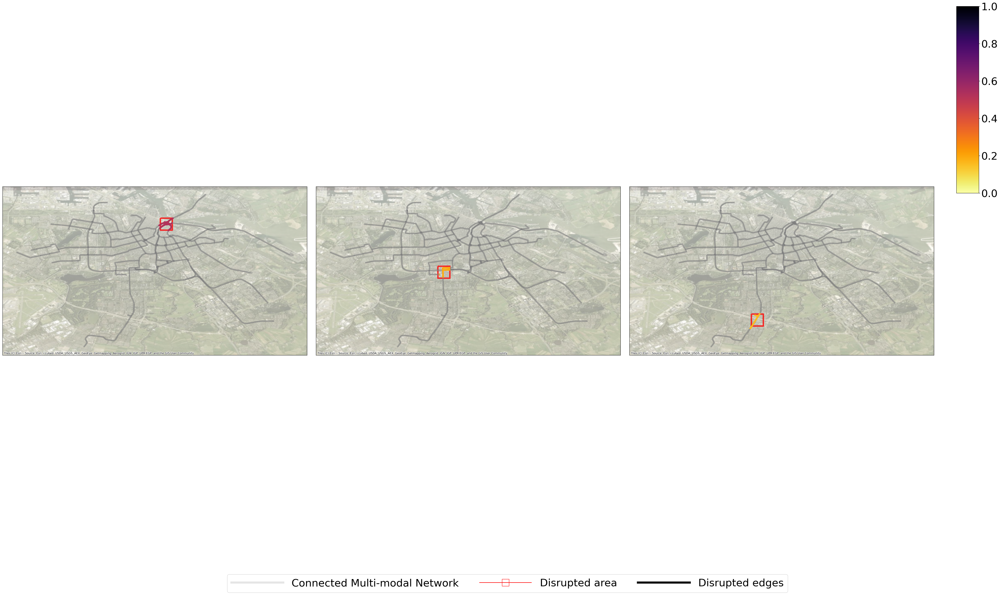

In [161]:
# scl_plt_worst_disrupted_grid(grid_1, worst_scl_each_disrupted_grid_1, city_two_layer_network_edges, worst_combined_removed_edges_df_1, worst_removed_edges_df_dict_1, 'scl_worst_3_disruption_scenario_grid_1_0917')

In [162]:
# def scl_plt_disrupted_grid_multi(grid, scl_each_disrupted_grid, city_two_layer_network_edges,
#                                  combined_removed_edges_df, removed_edges_df_dict,
#                                  plot_title, grid_nums):
#     """
#     Plot multiple disruption scenarios for specified Grid_num values.
#     Each subplot in a single column (one per row) shares the same colormap range (0 to 1).

#     Parameters
#     ----------
#     grid : GeoDataFrame
#         GeoDataFrame containing the grid polygons.
#     scl_each_disrupted_grid : DataFrame
#         DataFrame containing disruption metrics for each grid.
#     city_two_layer_network_edges : DataFrame or GeoDataFrame
#         Edge list of the network.
#     combined_removed_edges_df : DataFrame or GeoDataFrame
#         Combined edges affected by disruptions.
#     removed_edges_df_dict : dict
#         Dictionary mapping Grid_num to its disrupted edges GeoDataFrame.
#     plot_title : str
#         Title for the entire figure.
#     grid_nums : list[int] or int
#         List of Grid_num values (or a single int) to plot.
#     """

#     # Ensure grid_nums is a list
#     if isinstance(grid_nums, int):
#         grid_nums = [grid_nums]

#     # Load metro lines for CRS and basemap alignment
#     metro_lines = gpd.read_file("./Metro lines.GPKG")

#     # Prepare colormap (fixed 0–1 range)
#     cmap = plt.get_cmap('inferno_r')
#     norm = Normalize(vmin=0, vmax=1)

#     # Figure: one subplot per row
#     num_plots = len(grid_nums)
#     fig_height = 8 * num_plots   # 8 inches per subplot row
#     fig_width = 10
#     fig, axes = plt.subplots(num_plots, 1, figsize=(fig_width, fig_height))

#     if num_plots == 1:
#         axes = [axes]  # make iterable

#     plt.rcParams.update({'font.size': 20})

#     for ax, grid_num in zip(axes, grid_nums):
#         # Prepare data
#         city_edges_gdf = gpd.GeoDataFrame(city_two_layer_network_edges.copy(), geometry='geometry')
#         removed_edges_gdf = gpd.GeoDataFrame(removed_edges_df_dict[grid_num].copy(), geometry='geometry')
#         grid_gdf = gpd.GeoDataFrame(grid.loc[grid.index == grid_num].copy(), geometry='geometry')

#         # Base network
#         city_edges_gdf.plot(ax=ax, color='grey', linewidth=2.5, alpha=0.3)

#         # Disrupted edges (colored by simple_connectivity_loss)
#         removed_edges_gdf.plot(ax=ax, column='simple_connectivity_loss', linewidth=3,
#                                legend=False, cmap=cmap, norm=norm)

#         # Disrupted grid boundary
#         grid_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=3, alpha=0.8)

#         # Basemap
#         ctx.add_basemap(ax=ax, crs=metro_lines.crs.to_string(),
#                         source=ctx.providers.Esri.WorldImagery, alpha=0.4)

#         # Remove ticks
#         ax.set_xticks([])
#         ax.set_yticks([])

#         # Title for each subplot (pad moves upward by ~0.3 cm)
#         ax.set_title(f"Grid {grid_num}", fontsize=24, pad=10)

#     # Add shared colorbar (to the right of the last subplot)
#     sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
#     sm.set_array([])
#     cbar_ax = fig.add_axes([0.92, 0.1, 0.02, 0.8])  # position relative to figure
#     cbar = fig.colorbar(sm, cax=cbar_ax)
#     cbar.ax.tick_params(labelsize=18)

#     # Overall title (y shift upward by ~0.5 cm)
#     fig.suptitle(plot_title, fontsize=28, y=0.5)

#     # Adjust layout
#     plt.tight_layout(rect=[0, 0, 0.9, 1])  # leave space for colorbar
#     plt.savefig(f"{plot_title}.png", bbox_inches='tight', dpi=600)
#     plt.show()

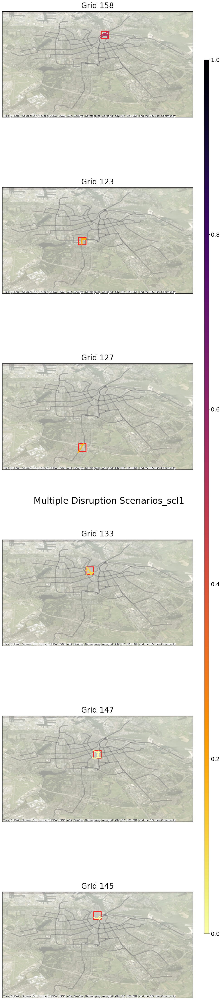

In [163]:
# scl_plt_disrupted_grid_multi(grid_1, scl_each_disrupted_grid_1, city_two_layer_network_edges, 
#                                   combined_removed_edges_df_1, removed_edges_df_dict_1,
#                              plot_title="Multiple Disruption Scenarios_scl1",
#                              grid_nums=[158,123,127,133,147,145])

In [164]:
scl_each_disrupted_grid_1[scl_each_disrupted_grid_1.Grid_num.isin([158,123,127,133,147,145])]

,simple_connectivity_loss,Grid_num
43,0.156633,127.0
47,0.097053,133.0
51,0.188283,123.0
58,0.000000,145.0
59,0.000000,147.0
60,0.525315,158.0


In [165]:
# def scl_plt_disrupted_grid_central_to_zuid(grid, scl_each_disrupted_grid, city_two_layer_network_edges,
#                                            combined_removed_edges_df, removed_edges_df_dict,
#                                            plot_title, grid_nums):
#     """
#     Plot disruption scenarios for specified Grid_num values,
#     limited to the Amsterdam Centraal to Zuid station area.
#     """

#     import geopandas as gpd
#     import matplotlib.pyplot as plt
#     from matplotlib.colors import Normalize
#     import contextily as ctx

#     # Ensure grid_nums is a list
#     if isinstance(grid_nums, int):
#         grid_nums = [grid_nums]

#     # Load metro lines for CRS
#     metro_lines = gpd.read_file("./Metro lines.GPKG")

#     # Define bounding box for Amsterdam Centraal → Zuid
#     # Coordinates in WGS84 (lon/lat), adjust if needed
#     # Rough box covering the area
#     bbox = {
#         "minx": 4.875,
#         "maxx": 4.90,
#         "miny": 52.35,
#         "maxy": 52.38
#     }

#     # Prepare colormap
#     cmap = plt.get_cmap('inferno_r')
#     norm = Normalize(vmin=0, vmax=1)

#     num_plots = len(grid_nums)
#     fig_height = 8 * num_plots
#     fig_width = 10
#     fig, axes = plt.subplots(num_plots, 1, figsize=(fig_width, fig_height))

#     if num_plots == 1:
#         axes = [axes]

#     plt.rcParams.update({'font.size': 20})

#     for ax, grid_num in zip(axes, grid_nums):
#         # Filter data within bounding box
#         city_edges_gdf = gpd.GeoDataFrame(city_two_layer_network_edges.copy(), geometry='geometry', crs=metro_lines.crs)
#         city_edges_gdf = city_edges_gdf.cx[bbox["minx"]:bbox["maxx"], bbox["miny"]:bbox["maxy"]]

#         removed_edges_gdf = gpd.GeoDataFrame(removed_edges_df_dict[grid_num].copy(), geometry='geometry', crs=metro_lines.crs)
#         removed_edges_gdf = removed_edges_gdf.cx[bbox["minx"]:bbox["maxx"], bbox["miny"]:bbox["maxy"]]

#         grid_gdf = gpd.GeoDataFrame(grid.loc[grid.index == grid_num].copy(), geometry='geometry', crs=metro_lines.crs)
#         grid_gdf = grid_gdf.cx[bbox["minx"]:bbox["maxx"], bbox["miny"]:bbox["maxy"]]

#         # Base network
#         city_edges_gdf.plot(ax=ax, color='grey', linewidth=2.5, alpha=0.3)

#         # Disrupted edges
#         removed_edges_gdf.plot(ax=ax, column='simple_connectivity_loss', linewidth=3,
#                                legend=False, cmap=cmap, norm=norm)

#         # Highlight grid
#         grid_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=3, alpha=0.8)

#         # Basemap
#         ctx.add_basemap(ax=ax, crs=metro_lines.crs.to_string(),
#                         source=ctx.providers.Esri.WorldImagery, alpha=0.4)

#         # Remove ticks
#         ax.set_xticks([])
#         ax.set_yticks([])

#         # Title for subplot
#         ax.set_title(f"Grid {grid_num}", fontsize=24, pad=10)

#     # Shared colorbar
#     sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
#     sm.set_array([])
#     cbar_ax = fig.add_axes([0.92, 0.1, 0.02, 0.8])
#     cbar = fig.colorbar(sm, cax=cbar_ax)
#     cbar.ax.tick_params(labelsize=18)

#     # Overall title
#     fig.suptitle(plot_title, fontsize=28, y=0.95)

#     plt.tight_layout(rect=[0, 0, 0.9, 1])
#     plt.savefig(f"{plot_title}.png", bbox_inches='tight', dpi=600)
#     plt.show()

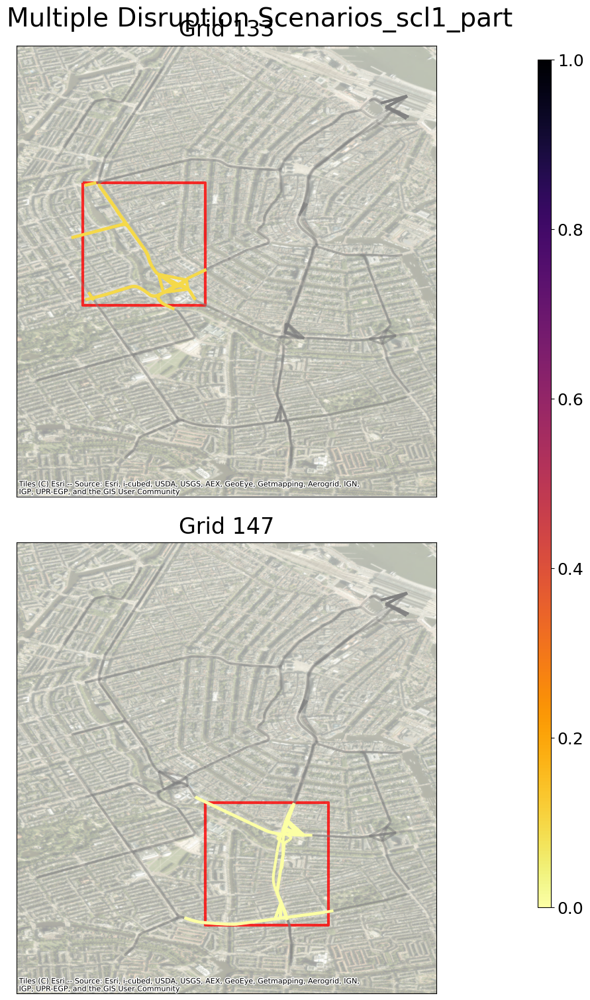

In [166]:
# scl_plt_disrupted_grid_central_to_zuid(grid_1, scl_each_disrupted_grid_1, city_two_layer_network_edges, 
#                                   combined_removed_edges_df_1, removed_edges_df_dict_1,
#                              plot_title="Multiple Disruption Scenarios_scl1_part",
#                              grid_nums=[133, 147])

In [204]:
def plt_disrupted_grid_central(grid, scl_each_disrupted_grid, city_two_layer_network_edges,
                               combined_removed_edges_df, removed_edges_df_dict,
                               plot_title, grid_nums):
    """
    Plot disruption scenarios for specified Grid_num values,
    limited to the Amsterdam Centraal area,
    with colorbar centered below the last subplot without overlap.
    """
    import geopandas as gpd
    import matplotlib.pyplot as plt
    from matplotlib.colors import Normalize
    import contextily as ctx
    import matplotlib.gridspec as gridspec


    # Ensure grid_nums is a list
    if isinstance(grid_nums, int):
        grid_nums = [grid_nums]

    # Load metro lines for CRS
    metro_lines = gpd.read_file("./Metro lines.GPKG")

    # Define bounding box for Amsterdam Centraal
    bbox = {
        "minx": 4.88,
        "maxx": 4.90,
        "miny": 52.35,
        "maxy": 52.375
    }

    # Prepare colormap
    # cmap = plt.get_cmap('inferno_r')
    # cmap = plt.get_cmap('plasma') 
    # cmap = plt.get_cmap('cividis')
    cmap = plt.get_cmap('Blues')
    norm = Normalize(vmin=0, vmax=1)

    num_plots = len(grid_nums)

    # Use gridspec to create extra row for colorbar
    fig = plt.figure(figsize=(10, 8 * num_plots + 1))  # +1 inch for colorbar
    gs = gridspec.GridSpec(num_plots + 1, 1, height_ratios=[8] * num_plots + [0.5])

    plt.rcParams.update({'font.size': 20})

    axes = []
    for i, grid_num in enumerate(grid_nums):
        ax = fig.add_subplot(gs[i, 0])
        axes.append(ax)

        # Filter data within bounding box
        city_edges_gdf = gpd.GeoDataFrame(city_two_layer_network_edges.copy(), geometry='geometry', crs=metro_lines.crs)
        city_edges_gdf = city_edges_gdf.cx[bbox["minx"]:bbox["maxx"], bbox["miny"]:bbox["maxy"]]

        removed_edges_gdf = gpd.GeoDataFrame(removed_edges_df_dict[grid_num].copy(), geometry='geometry', crs=metro_lines.crs)
        removed_edges_gdf = removed_edges_gdf.cx[bbox["minx"]:bbox["maxx"], bbox["miny"]:bbox["maxy"]]

        grid_gdf = gpd.GeoDataFrame(grid.loc[grid.index == grid_num].copy(), geometry='geometry', crs=metro_lines.crs)
        grid_gdf = grid_gdf.cx[bbox["minx"]:bbox["maxx"], bbox["miny"]:bbox["maxy"]]

        # Base network
        city_edges_gdf.plot(ax=ax, color='grey', linewidth=2.5, alpha=0.3)

        # Disrupted edges
        removed_edges_gdf.plot(ax=ax, column='simple_connectivity_loss', linewidth=3,
                               legend=False, cmap=cmap, norm=norm)

        # Highlight grid
        grid_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=3, alpha=0.8)

        # Basemap
        ctx.add_basemap(ax=ax, crs=metro_lines.crs.to_string(),
                        source=ctx.providers.Esri.WorldImagery, alpha=0.4, attribution=False)

        # Remove ticks
        ax.set_xticks([])
        ax.set_yticks([])

        # Title for subplot
        ax.set_title(f"Grid {grid_num}", fontsize=24, pad=10)

    # Colorbar in the last row
    cax = fig.add_subplot(gs[-1, 0])  # last row for colorbar
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    cbar = fig.colorbar(sm, cax=cax, orientation="horizontal")
    cbar.ax.tick_params(labelsize=18)

    # Overall title
    fig.suptitle(plot_title, fontsize=28, y=0.995)

    plt.tight_layout(rect=[0, 0, 1, 0.97])  # leave space for title
    plt.savefig(f"{plot_title}.png", bbox_inches='tight', dpi=600)
    plt.show()

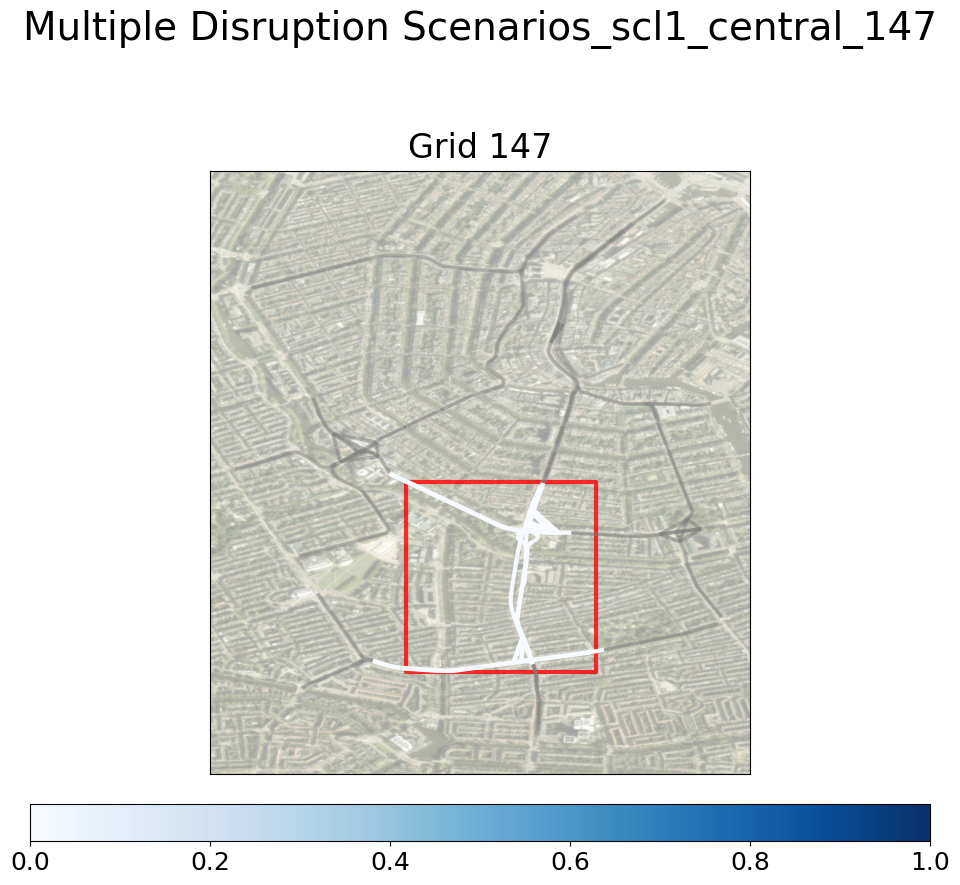

In [205]:
plt_disrupted_grid_central(grid_1, scl_each_disrupted_grid_1, city_two_layer_network_edges, 
                                  combined_removed_edges_df_1, removed_edges_df_dict_1,
                             plot_title="Multiple Disruption Scenarios_scl1_central_147",
                             grid_nums=[147])

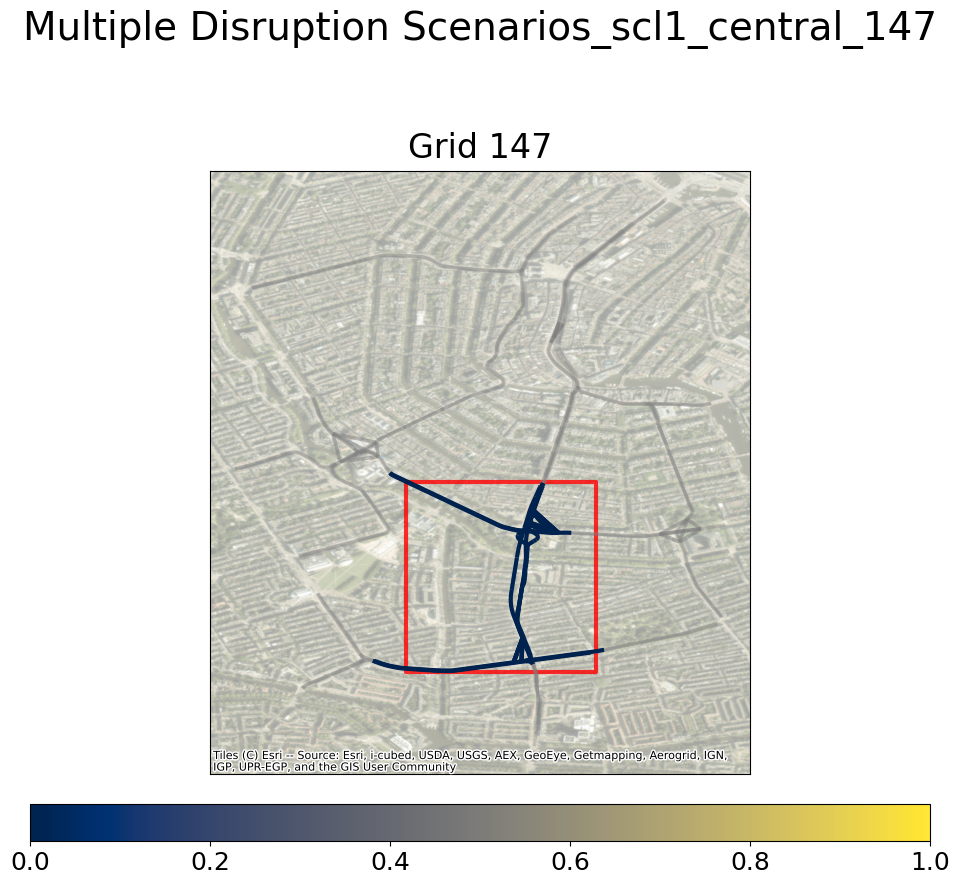

In [194]:
plt_disrupted_grid_central(grid_1, scl_each_disrupted_grid_1, city_two_layer_network_edges, 
                                  combined_removed_edges_df_1, removed_edges_df_dict_1,
                             plot_title="Multiple Disruption Scenarios_scl1_central_147",
                             grid_nums=[147])

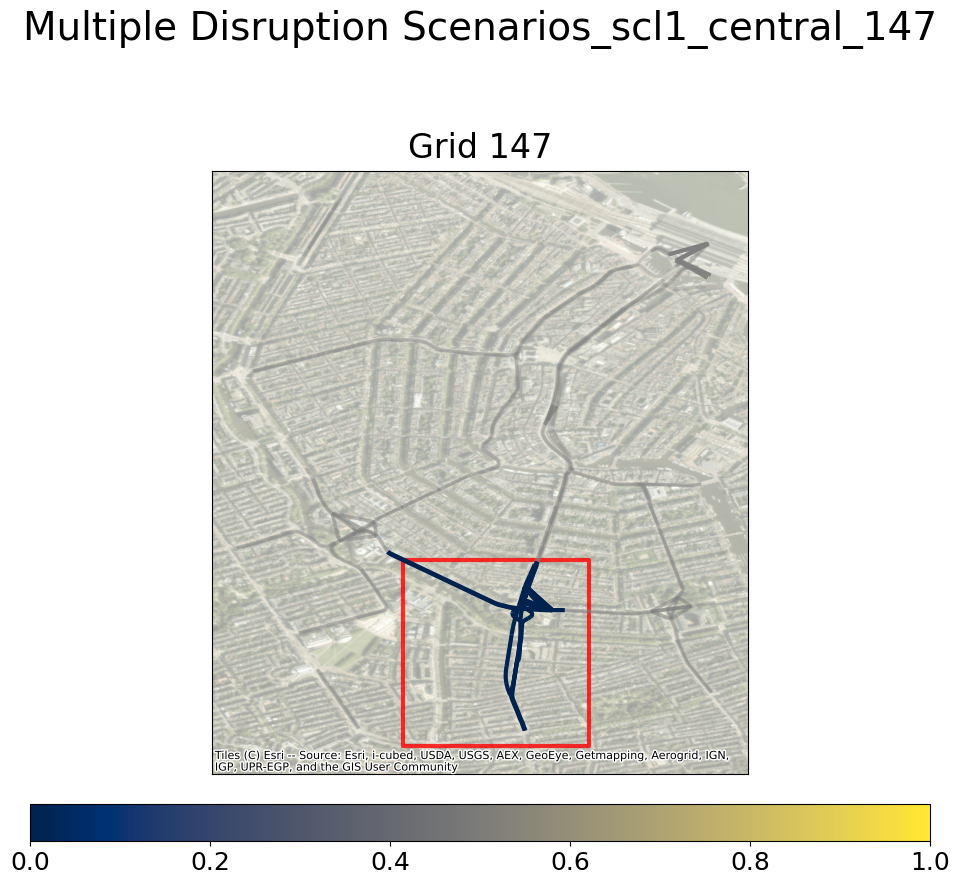

In [177]:
plt_disrupted_grid_central(grid_1, scl_each_disrupted_grid_1, city_two_layer_network_edges, 
                                  combined_removed_edges_df_1, removed_edges_df_dict_1,
                             plot_title="Multiple Disruption Scenarios_scl1_central_147",
                             grid_nums=[147])

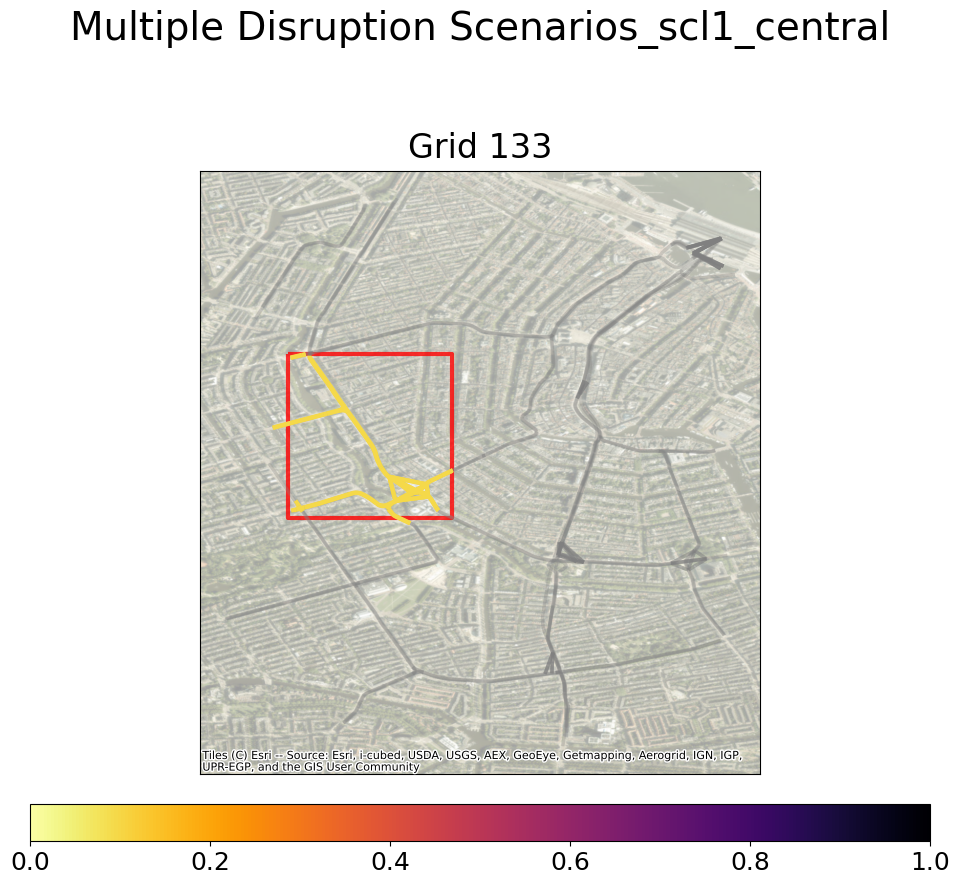

In [168]:
# plt_disrupted_grid_central(grid_1, scl_each_disrupted_grid_1, city_two_layer_network_edges, 
#                                   combined_removed_edges_df_1, removed_edges_df_dict_1,
#                              plot_title="Multiple Disruption Scenarios_scl1_central",
#                              grid_nums=[133])

### Grid2  0.02

In [199]:
grid_2, grid_edges_dict_2, disruption_scenario_grid_list_2 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.02)

In [201]:
OD_dis_shortest_path_edges_dict_2, removed_edges_df_dict_2, combined_removed_edges_df_2, scl_each_disrupted_grid_2 = scl_each_disrupted_grid(grid_edges_dict_2,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [216]:
scl_each_disrupted_grid_2.to_excel("scl_grid_2.xlsx", header = True,index = False)

In [211]:
def plt_disrupted_grid_central2(grid, scl_each_disrupted_grid, city_two_layer_network_edges,
                               combined_removed_edges_df, removed_edges_df_dict,
                               plot_title, grid_nums):
    """
    Plot disruption scenarios for specified Grid_num values,
    limited to the Amsterdam Centraal area,
    with colorbar centered below the last subplot without overlap.
    """
    import geopandas as gpd
    import matplotlib.pyplot as plt
    from matplotlib.colors import Normalize
    import contextily as ctx
    import matplotlib.gridspec as gridspec


    # Ensure grid_nums is a list
    if isinstance(grid_nums, int):
        grid_nums = [grid_nums]

    # Load metro lines for CRS
    metro_lines = gpd.read_file("./Metro lines.GPKG")

    # Define bounding box for Amsterdam Centraal
    bbox = {
        "minx": 4.876,
        "maxx": 4.895,
        "miny": 52.34,
        "maxy": 52.375
    }

    # Prepare colormap
    # cmap = plt.get_cmap('inferno_r')
    # cmap = plt.get_cmap('plasma') 
    # cmap = plt.get_cmap('cividis')
    cmap = plt.get_cmap('Blues')
    norm = Normalize(vmin=0, vmax=1)

    num_plots = len(grid_nums)

    # Use gridspec to create extra row for colorbar
    fig = plt.figure(figsize=(10, 8 * num_plots + 1))  # +1 inch for colorbar
    gs = gridspec.GridSpec(num_plots + 1, 1, height_ratios=[8] * num_plots + [0.5])

    plt.rcParams.update({'font.size': 20})

    axes = []
    for i, grid_num in enumerate(grid_nums):
        ax = fig.add_subplot(gs[i, 0])
        axes.append(ax)

        # Filter data within bounding box
        city_edges_gdf = gpd.GeoDataFrame(city_two_layer_network_edges.copy(), geometry='geometry', crs=metro_lines.crs)
        city_edges_gdf = city_edges_gdf.cx[bbox["minx"]:bbox["maxx"], bbox["miny"]:bbox["maxy"]]

        removed_edges_gdf = gpd.GeoDataFrame(removed_edges_df_dict[grid_num].copy(), geometry='geometry', crs=metro_lines.crs)
        removed_edges_gdf = removed_edges_gdf.cx[bbox["minx"]:bbox["maxx"], bbox["miny"]:bbox["maxy"]]

        grid_gdf = gpd.GeoDataFrame(grid.loc[grid.index == grid_num].copy(), geometry='geometry', crs=metro_lines.crs)
        grid_gdf = grid_gdf.cx[bbox["minx"]:bbox["maxx"], bbox["miny"]:bbox["maxy"]]

        # Base network
        city_edges_gdf.plot(ax=ax, color='grey', linewidth=2.5, alpha=0.3)

        # Disrupted edges
        removed_edges_gdf.plot(ax=ax, column='simple_connectivity_loss', linewidth=3,
                               legend=False, cmap=cmap, norm=norm)

        # Highlight grid
        grid_gdf.plot(ax=ax, edgecolor='red', facecolor='none', linewidth=3, alpha=0.8)

        # Basemap
        ctx.add_basemap(ax=ax, crs=metro_lines.crs.to_string(),
                        source=ctx.providers.Esri.WorldImagery, alpha=0.4, attribution=False)

        # Remove ticks
        ax.set_xticks([])
        ax.set_yticks([])

        # Title for subplot
        ax.set_title(f"Grid {grid_num}", fontsize=24, pad=10)

    # Colorbar in the last row
    cax = fig.add_subplot(gs[-1, 0])  # last row for colorbar
    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    cbar = fig.colorbar(sm, cax=cax, orientation="horizontal")
    cbar.ax.tick_params(labelsize=18)

    # Overall title
    fig.suptitle(plot_title, fontsize=28, y=0.995)

    plt.tight_layout(rect=[0, 0, 1, 0.97])  # leave space for title
    plt.savefig(f"{plot_title}.png", bbox_inches='tight', dpi=600)
    plt.show()

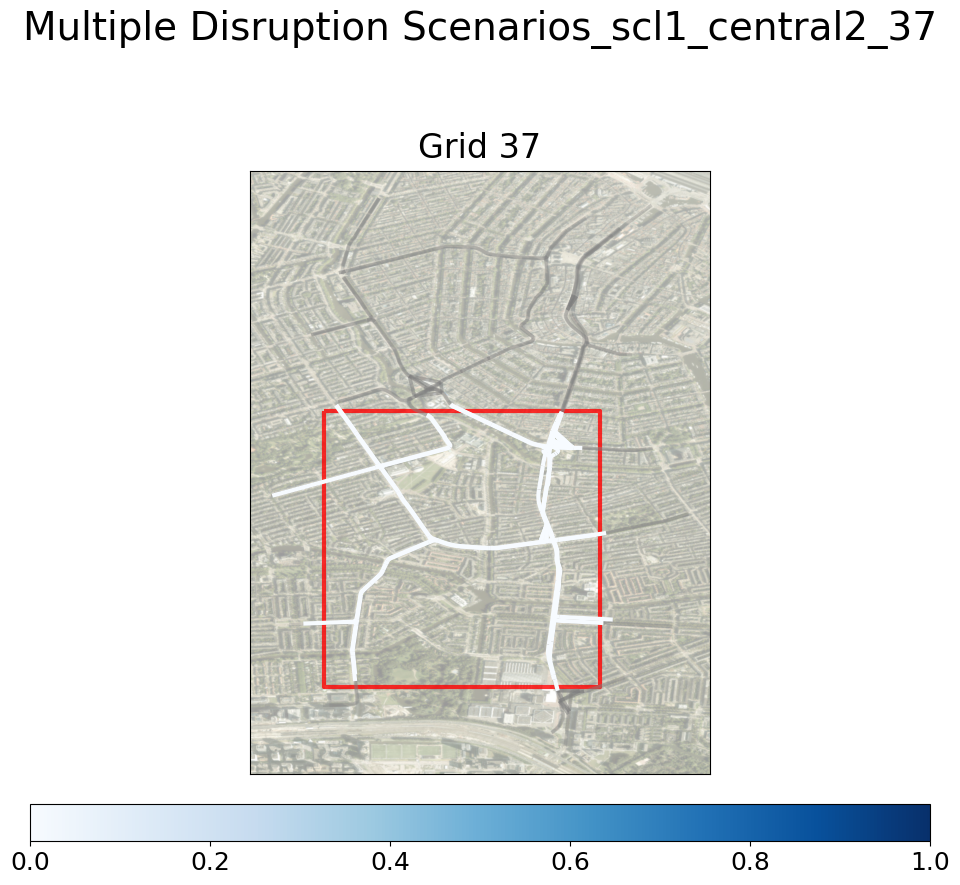

In [212]:
plt_disrupted_grid_central2(grid_2, scl_each_disrupted_grid_2, city_two_layer_network_edges, 
                                  combined_removed_edges_df_2, removed_edges_df_dict_2,
                             plot_title="Multiple Disruption Scenarios_scl1_central2_37",
                             grid_nums=[37])

### Grid2  0.02

In [162]:
grid_2, grid_edges_dict_2, disruption_scenario_grid_list_2 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.02)

In [163]:
OD_dis_shortest_path_edges_dict_2, removed_edges_df_dict_2, combined_removed_edges_df_2, scl_each_disrupted_grid_2 = scl_each_disrupted_grid(grid_edges_dict_2,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [164]:
worst_scl_each_disrupted_grid_2,worst_combined_removed_edges_df_2,worst_removed_edges_df_dict_2 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_2,removed_edges_df_dict_2,combined_removed_edges_df_2)

In [165]:
worst_scl_each_disrupted_grid_2

,simple_connectivity_loss,Grid_num
24,0.626853,43.0
5,0.243761,22.0
13,0.216162,31.0


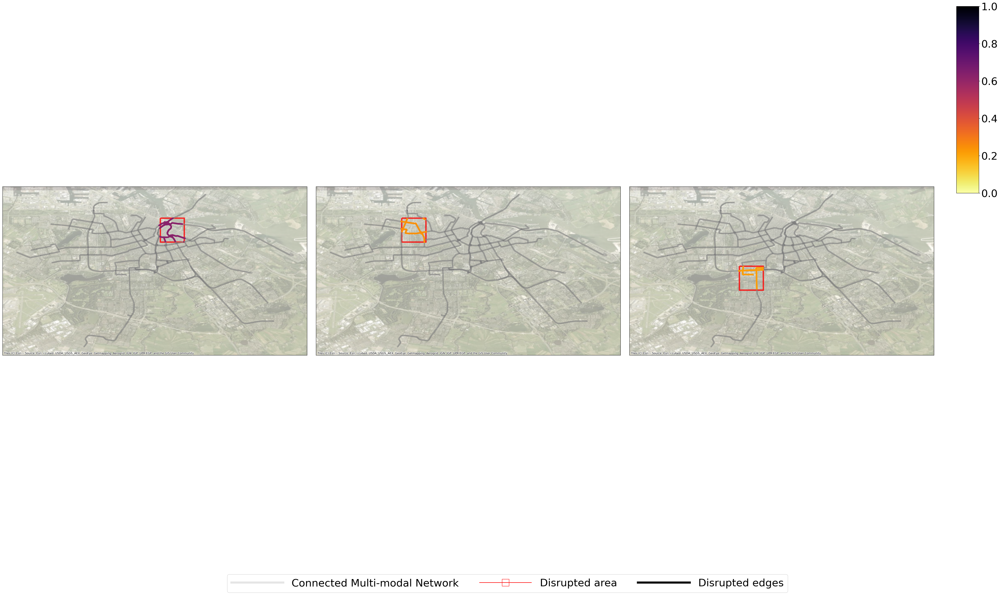

In [166]:
scl_plt_worst_disrupted_grid(grid_2, worst_scl_each_disrupted_grid_2, city_two_layer_network_edges, worst_combined_removed_edges_df_2, worst_removed_edges_df_dict_2, 'scl_worst_3_disruption_scenario_grid_2_0917')

## 0917

### Grid1 0.01

In [155]:
grid_1, grid_edges_dict_1, disruption_scenario_grid_list_1 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.01)

In [156]:
OD_dis_shortest_path_edges_dict_1, removed_edges_df_dict_1, combined_removed_edges_df_1, scl_each_disrupted_grid_1 = scl_each_disrupted_grid(grid_edges_dict_1,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [157]:
scl_each_disrupted_grid_1

,simple_connectivity_loss,Grid_num
0,0.064284,4.0
1,0.064284,5.0
2,0.064284,17.0
3,0.126143,30.0
4,0.064284,18.0
...,...,...
116,0.060606,283.0
117,0.064284,277.0
118,0.064284,290.0
119,0.064284,291.0


In [158]:
worst_scl_each_disrupted_grid_1,worst_combined_removed_edges_df_1,worst_removed_edges_df_dict_1 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_1,removed_edges_df_dict_1,combined_removed_edges_df_1)

In [159]:
worst_scl_each_disrupted_grid_1

,simple_connectivity_loss,Grid_num
60,0.525315,158.0
51,0.188283,123.0
43,0.156633,127.0


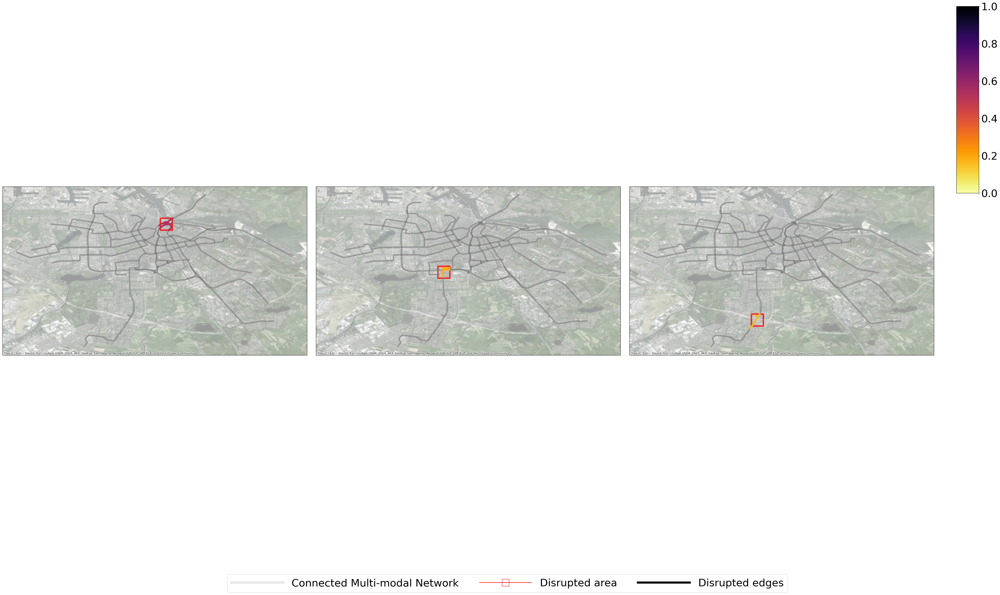

In [160]:
scl_plt_worst_disrupted_grid(grid_1, worst_scl_each_disrupted_grid_1, city_two_layer_network_edges, worst_combined_removed_edges_df_1, worst_removed_edges_df_dict_1, 'scl_worst_3_disruption_scenario_grid_1_0917')

### Grid2  0.02

In [161]:
grid_2, grid_edges_dict_2, disruption_scenario_grid_list_2 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.02)

In [162]:
OD_dis_shortest_path_edges_dict_2, removed_edges_df_dict_2, combined_removed_edges_df_2, scl_each_disrupted_grid_2 = scl_each_disrupted_grid(grid_edges_dict_2,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [163]:
worst_scl_each_disrupted_grid_2,worst_combined_removed_edges_df_2,worst_removed_edges_df_dict_2 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_2,removed_edges_df_dict_2,combined_removed_edges_df_2)

In [164]:
worst_scl_each_disrupted_grid_2

,simple_connectivity_loss,Grid_num
24,0.626853,43.0
5,0.243761,22.0
13,0.216162,31.0


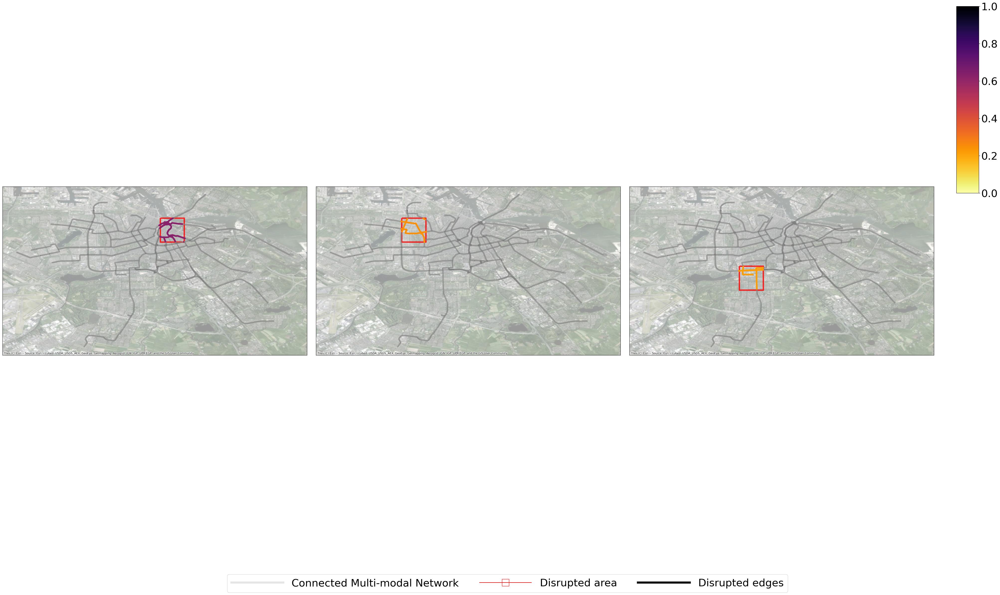

In [165]:
scl_plt_worst_disrupted_grid(grid_2, worst_scl_each_disrupted_grid_2, city_two_layer_network_edges, worst_combined_removed_edges_df_2, worst_removed_edges_df_dict_2, 'scl_worst_3_disruption_scenario_grid_2_0917')

### Grid3  0.03

In [166]:
grid_3, grid_edges_dict_3, disruption_scenario_grid_list_3 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.03)

In [167]:
OD_dis_shortest_path_edges_dict_3, removed_edges_df_dict_3, combined_removed_edges_df_3, scl_each_disrupted_grid_3 = scl_each_disrupted_grid(grid_edges_dict_3,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [168]:
worst_scl_each_disrupted_grid_3,worst_combined_removed_edges_df_3,worst_removed_edges_df_dict_3 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_3,removed_edges_df_dict_3,combined_removed_edges_df_3)

In [169]:
worst_scl_each_disrupted_grid_3

,simple_connectivity_loss,Grid_num
13,0.525315,20.0
4,0.311639,11.0
14,0.307205,17.0


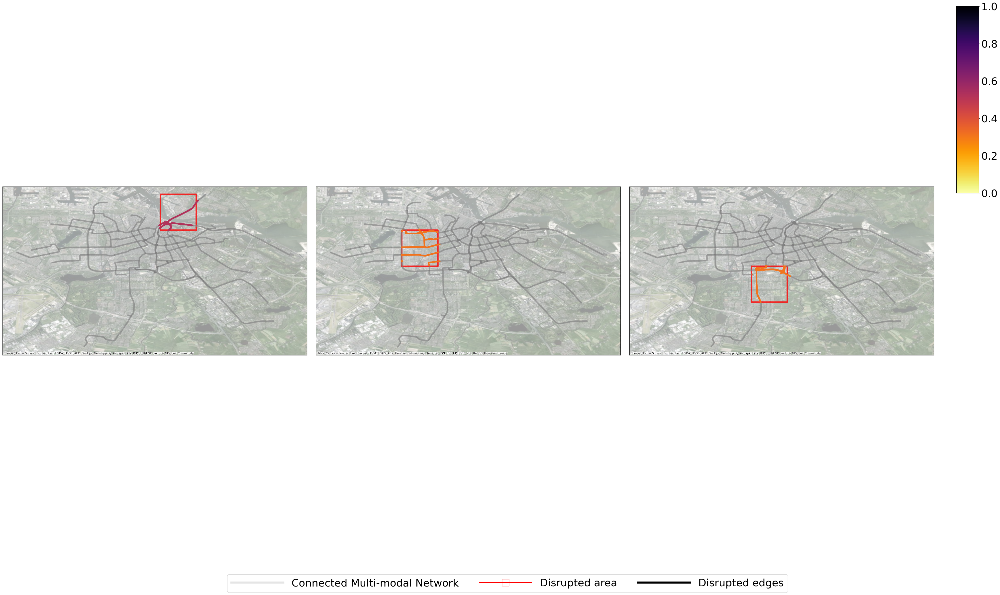

In [170]:
scl_plt_worst_disrupted_grid(grid_3, worst_scl_each_disrupted_grid_3, city_two_layer_network_edges, worst_combined_removed_edges_df_3, worst_removed_edges_df_dict_3, 'scl_worst_3_disruption_scenario_grid_3_0917')

## 0916

### Grid1 0.01

In [153]:
grid_1, grid_edges_dict_1, disruption_scenario_grid_list_1 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.01)

In [154]:
OD_dis_shortest_path_edges_dict_1, removed_edges_df_dict_1, combined_removed_edges_df_1, scl_each_disrupted_grid_1 = scl_each_disrupted_grid(grid_edges_dict_1,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [155]:
scl_each_disrupted_grid_1

,simple_connectivity_loss,Grid_num
0,0.064284,4.0
1,0.064284,5.0
2,0.064284,17.0
3,0.126143,30.0
4,0.064284,18.0
...,...,...
116,0.060606,283.0
117,0.064284,277.0
118,0.064284,290.0
119,0.064284,291.0


In [156]:
worst_scl_each_disrupted_grid_1,worst_combined_removed_edges_df_1,worst_removed_edges_df_dict_1 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_1,removed_edges_df_dict_1,combined_removed_edges_df_1)

In [157]:
worst_scl_each_disrupted_grid_1

,simple_connectivity_loss,Grid_num
60,0.525315,158.0
51,0.188283,123.0
43,0.156633,127.0


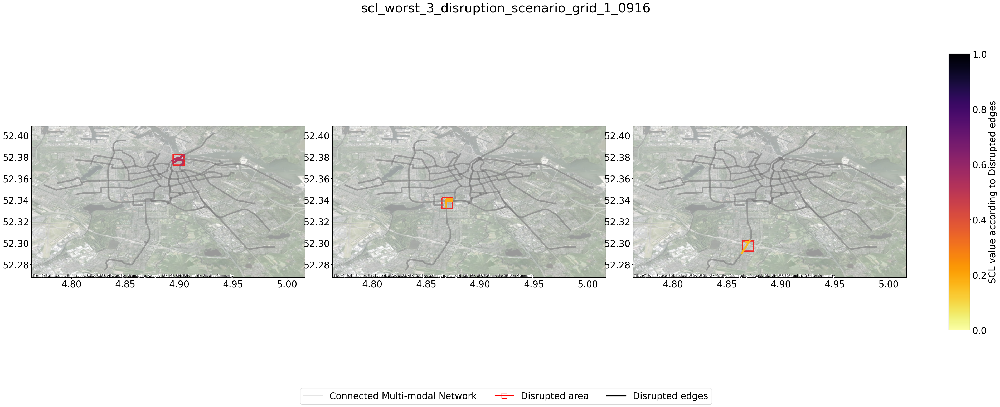

In [169]:
scl_plt_worst_disrupted_grid(grid_1, worst_scl_each_disrupted_grid_1, city_two_layer_network_edges, worst_combined_removed_edges_df_1, worst_removed_edges_df_dict_1, 'scl_worst_3_disruption_scenario_grid_1_0916')

### Grid2  0.02

In [159]:
grid_2, grid_edges_dict_2, disruption_scenario_grid_list_2 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.02)

In [160]:
OD_dis_shortest_path_edges_dict_2, removed_edges_df_dict_2, combined_removed_edges_df_2, scl_each_disrupted_grid_2 = scl_each_disrupted_grid(grid_edges_dict_2,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [161]:
worst_scl_each_disrupted_grid_2,worst_combined_removed_edges_df_2,worst_removed_edges_df_dict_2 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_2,removed_edges_df_dict_2,combined_removed_edges_df_2)

In [162]:
worst_scl_each_disrupted_grid_2

,simple_connectivity_loss,Grid_num
24,0.626853,43.0
5,0.243761,22.0
13,0.216162,31.0


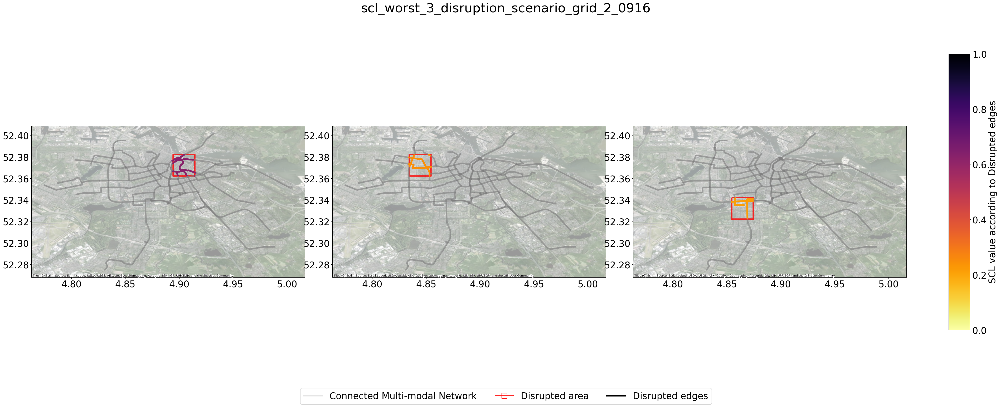

In [163]:
scl_plt_worst_disrupted_grid(grid_2, worst_scl_each_disrupted_grid_2, city_two_layer_network_edges, worst_combined_removed_edges_df_2, worst_removed_edges_df_dict_2, 'scl_worst_3_disruption_scenario_grid_2_0916')

### Grid3  0.03

In [164]:
grid_3, grid_edges_dict_3, disruption_scenario_grid_list_3 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.03)

In [165]:
OD_dis_shortest_path_edges_dict_3, removed_edges_df_dict_3, combined_removed_edges_df_3, scl_each_disrupted_grid_3 = scl_each_disrupted_grid(grid_edges_dict_3,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [166]:
worst_scl_each_disrupted_grid_3,worst_combined_removed_edges_df_3,worst_removed_edges_df_dict_3 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_3,removed_edges_df_dict_3,combined_removed_edges_df_3)

In [167]:
worst_scl_each_disrupted_grid_3

,simple_connectivity_loss,Grid_num
13,0.525315,20.0
4,0.311639,11.0
14,0.307205,17.0


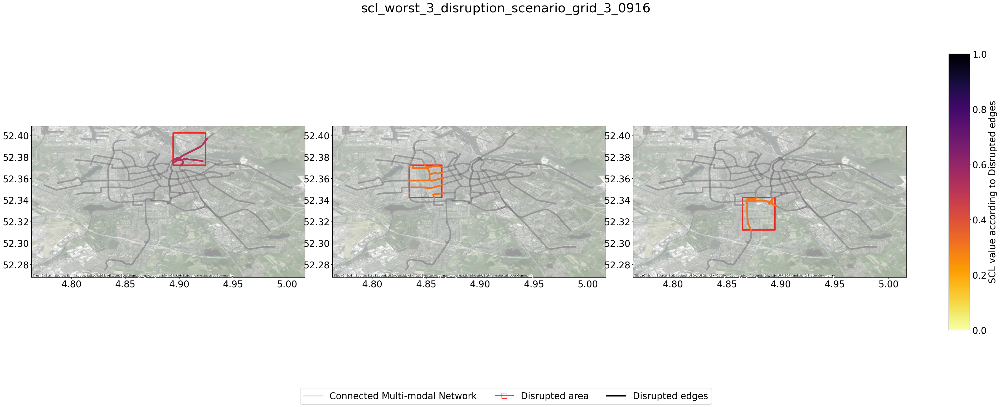

In [168]:
scl_plt_worst_disrupted_grid(grid_3, worst_scl_each_disrupted_grid_3, city_two_layer_network_edges, worst_combined_removed_edges_df_3, worst_removed_edges_df_dict_3, 'scl_worst_3_disruption_scenario_grid_3_0916')

## 0913

### Grid1 0.01

In [153]:
grid_1, grid_edges_dict_1, disruption_scenario_grid_list_1 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.01)

In [154]:
OD_dis_shortest_path_edges_dict_1, removed_edges_df_dict_1, combined_removed_edges_df_1, scl_each_disrupted_grid_1 = scl_each_disrupted_grid(grid_edges_dict_1,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [155]:
scl_each_disrupted_grid_1

,simple_connectivity_loss,Grid_num
0,0.064284,4.0
1,0.064284,5.0
2,0.064284,17.0
3,0.126143,30.0
4,0.064284,18.0
...,...,...
116,0.060606,283.0
117,0.064284,277.0
118,0.064284,290.0
119,0.064284,291.0


In [156]:
worst_scl_each_disrupted_grid_1,worst_combined_removed_edges_df_1,worst_removed_edges_df_dict_1 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_1,removed_edges_df_dict_1,combined_removed_edges_df_1)

In [157]:
worst_scl_each_disrupted_grid_1

,simple_connectivity_loss,Grid_num
60,0.525315,158.0
51,0.188283,123.0
43,0.156633,127.0


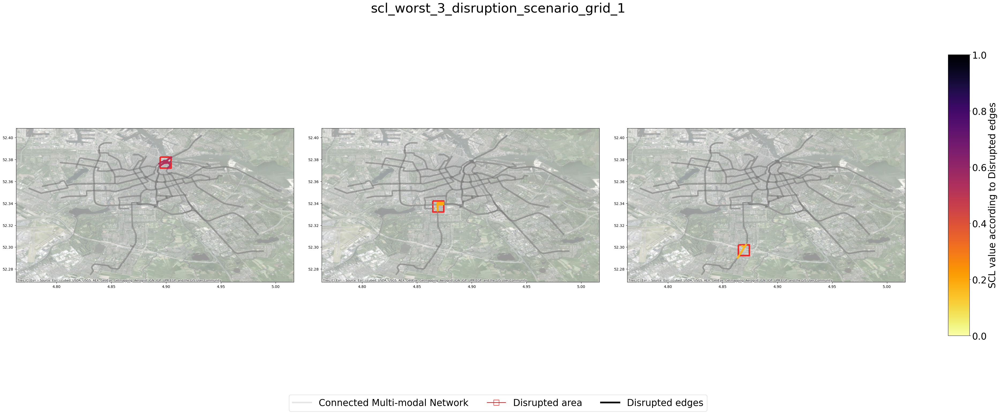

In [158]:
scl_plt_worst_disrupted_grid(grid_1, worst_scl_each_disrupted_grid_1, city_two_layer_network_edges, worst_combined_removed_edges_df_1, worst_removed_edges_df_dict_1, 'scl_worst_3_disruption_scenario_grid_1')

### Grid2  0.02

In [159]:
grid_2, grid_edges_dict_2, disruption_scenario_grid_list_2 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.02)

In [160]:
OD_dis_shortest_path_edges_dict_2, removed_edges_df_dict_2, combined_removed_edges_df_2, scl_each_disrupted_grid_2 = scl_each_disrupted_grid(grid_edges_dict_2,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [161]:
worst_scl_each_disrupted_grid_2,worst_combined_removed_edges_df_2,worst_removed_edges_df_dict_2 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_2,removed_edges_df_dict_2,combined_removed_edges_df_2)

In [162]:
worst_scl_each_disrupted_grid_2

,simple_connectivity_loss,Grid_num
24,0.626853,43.0
5,0.243761,22.0
13,0.216162,31.0


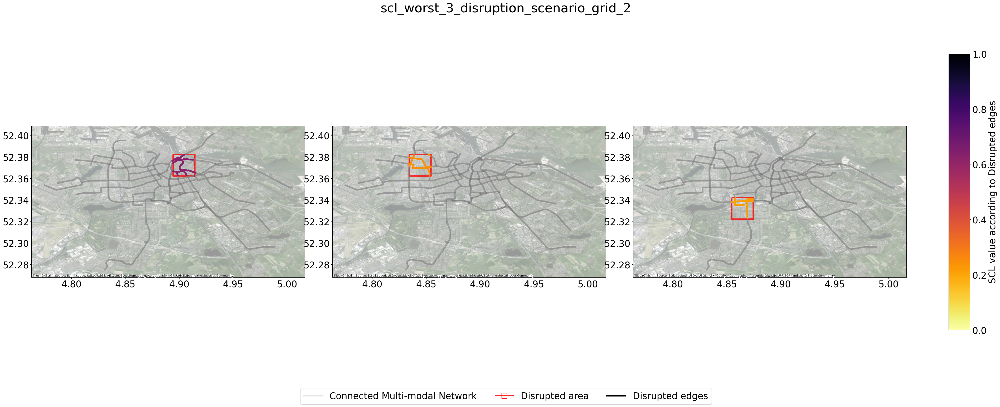

In [163]:
scl_plt_worst_disrupted_grid(grid_2, worst_scl_each_disrupted_grid_2, city_two_layer_network_edges, worst_combined_removed_edges_df_2, worst_removed_edges_df_dict_2, 'scl_worst_3_disruption_scenario_grid_2')

### Grid3  0.03

In [164]:
grid_3, grid_edges_dict_3, disruption_scenario_grid_list_3 = edges_in_grid_dfs_dict(city_two_layer_network_edges,0.03)

In [165]:
OD_dis_shortest_path_edges_dict_3, removed_edges_df_dict_3, combined_removed_edges_df_3, scl_each_disrupted_grid_3 = scl_each_disrupted_grid(grid_edges_dict_3,city_two_layer_network_edges,city_two_layer_network_nodes,OD_id_pairs_df,destination_id_df)

In [166]:
worst_scl_each_disrupted_grid_3,worst_combined_removed_edges_df_3,worst_removed_edges_df_dict_3 = scl_worst_disrupted_grid_results(scl_each_disrupted_grid_3,removed_edges_df_dict_3,combined_removed_edges_df_3)

In [167]:
worst_scl_each_disrupted_grid_3

,simple_connectivity_loss,Grid_num
13,0.525315,20.0
4,0.311639,11.0
14,0.307205,17.0


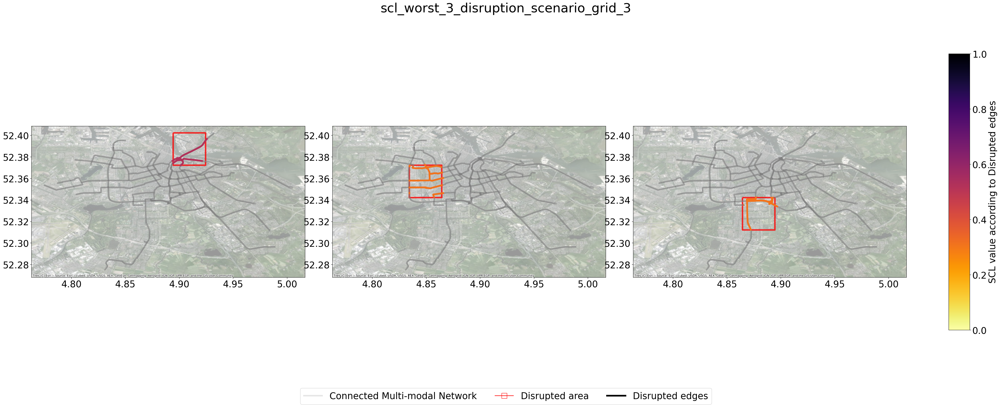

In [168]:
scl_plt_worst_disrupted_grid(grid_3, worst_scl_each_disrupted_grid_3, city_two_layer_network_edges, worst_combined_removed_edges_df_3, worst_removed_edges_df_dict_3, 'scl_worst_3_disruption_scenario_grid_3')